In [1]:
import pandas as pd
import os
from MILWRM.MxIF import *
from sklearn.cluster import KMeans
from sklearn.utils import shuffle
from skimage.filters import gaussian
import umap
import itertools
import scipy as scipy

In [2]:
plt.rcParams["font.family"] = "sans-serif"

In [3]:
import PIL

In [4]:
PIL.Image.MAX_IMAGE_PIXELS = None

In [5]:
image_info_df = pd.read_csv("/media/disk2/atlas_mxif/data/slideRegion_imagePaths.csv")
image_info_df.loc[0:40][['slide_region', 'tumorMask', 'broadTissue']]

,slide_region,tumorMask,broadTissue
0,HTA11_10167_0000_01_01_region_001,NaN,SSL
1,HTA11_10167_0000_01_01_region_002,NaN,SSL
2,HTA11_10167_0000_01_01_region_003,/media/disk2/atlas_mxif/BALANCED/HTA11_10167_0...,SSL
3,HTA11_10167_0000_01_01_region_004,NaN,SSL
4,HTA11_10623_0000_01_01_region_001,NaN,AD
5,HTA11_10623_0000_01_01_region_002,NaN,AD
6,HTA11_10623_0000_01_01_region_003,NaN,AD
7,HTA11_10623_0000_01_01_region_004,/media/disk2/atlas_mxif/BALANCED/HTA11_10623_0...,AD
8,HTA11_10623_0000_01_01_region_005,NaN,AD
9,HTA11_10623_0000_01_01_region_006,NaN,AD


In [6]:
# CD4 and CD45 are read similarly so _ needs to be added at the end of CD4

markers = ["BCATENIN","CD20","CD3D","CD4_","CD68","CD8","CGA",\
           "COLLAGEN","ERBB2","FOXP3","HLAA","LYSOZYME","MUC2","NAKATPASE","OLFM4","PANCK","PCNA","PEGFR","PSTAT3","SMA","SOX9","VIMENTIN","GACTIN","CDX2","MUC5AC","DAPI"]

In [7]:
# phenotypic markers used for domain detection
clustermarkers = ["BCATENIN","COLLAGEN","ERBB2","HLAA","LYSOZYME","MUC2","NAKATPASE","OLFM4","PANCK","PCNA","PEGFR","PSTAT3","SMA","SOX9","VIMENTIN","GACTIN","MUC5AC","CDX2"]

#### uncomment if reading images from scratch

In [8]:
# def read_img_downsample(tiffdir, common_string_name, channels
#                         , batch , mask_name = None, compress_save = False, path_save = False, downsample_factor = 16):
#     """
#     """
#     test_file = tiffdir + channels[0]+common_string_name
#     if os.path.exists(test_file):
#         image = img.from_tiffs(tiffdir = tiffdir ,channels = markers,common_strings = common_string_name, mask= mask_name)
#         image.scale()
#         image.downsample(downsample_factor)
#         if mask_name == None:
#             image.create_tissue_mask(features = None)
#         mean_estimator, pixels = image.calculate_non_zero_mean()
#         if compress_save == True:
#             if path_save == None:
#                 raise Exception("path to save npz file cannot be none")
#             path_to_save = os.path.join(path_save,'downsampled_files')
#             if not os.path.exists(path_to_save):
#                 os.mkdir(path_to_save)
#             npz_name = batch + common_string_name.split(".")[0] + "_downsampled"
#             file_save = os.path.join(path_to_save, npz_name)
#             image.to_npz(file_save)
#             image = file_save
#         return image, batch, mean_estimator, pixels

In [9]:
# %%time
# common_string_names = ["_ADJ_region_00" + str(i) + ".jpg" for i in range(1,7)]
# batches = ['HTA11_10167_0000_01_01', 'HTA11_10623_0000_01_01','HTA11_10711_0000_01_01', 'HTA11_4255_0000_02_02',
#        'HTA11_6298_0000_04A_03', 'HTA11_6801_0000_01_01',
#        'HTA11_7179_0000_02_02','HTA11_7862_0000_02_02', 'HTA11_7956_0000_02_05',
#        'HTA11_8099_0000_02_01', 'HTA11_8622_0000_01E_01',
#        'HTA11_866_0000_02_03', 'HTA11_8920_0000_02_02',
#        'HTA11_9341_0000_01A_01', 'HTA11_9408_0000_02A_05',]
# image_df = pd.DataFrame(columns = ['Img', 'batch_names', 'mean estimators', 'pixels'])
# for batch in batches:
#     tiffdir = "/media/disk2/atlas_mxif/BALANCED/" + batch + "/"
#     path_save = "/media/disk2/atlas_mxif/BALANCED/"
#     for common_string_name in common_string_names:
#         dat = read_img_downsample(tiffdir, common_string_name, markers
#                         , batch, compress_save = True, path_save = path_save)
#         if dat is not None:
#             dat_df = pd.DataFrame(dat).T
#             dat_df.columns = ['Img', 'batch_names', 'mean estimators', 'pixels']
#             image_df = pd.concat([image_df,dat_df], ignore_index= True)

In [10]:
# image_df
# image_df.to_csv("/media/disk2/atlas_mxif/BALANCED/mxif_labeler_df.csv")

In [8]:
image_df = pd.read_csv("/media/disk2/atlas_mxif/BALANCED/mxif_labeler_df.csv",index_col = [0], converters={'mean estimators': pd.eval})

In [9]:
image_df

,Img,batch_names,mean estimators,pixels
0,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10167_0000_01_01,"[282591.994712504, 32176.861085088716, 64844.4...",1776079
1,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10167_0000_01_01,"[228728.10892265203, 19687.880163188325, 61564...",1932126
2,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10167_0000_01_01,"[527694.5797524302, 51931.77592149802, 159176....",3607673
3,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10167_0000_01_01,"[71090.22398305533, 2889.9161654087534, 8730.4...",343251
4,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10623_0000_01_01,"[213308.09422480085, 81702.82174635757, 46633....",1772724
5,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10623_0000_01_01,"[209660.1657607433, 112934.04136930079, 42660....",1599556
6,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10623_0000_01_01,"[122603.7368067076, 32721.41472236417, 88484.1...",1059038
7,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10623_0000_01_01,"[175663.6814760054, 62044.60016916815, 46800.1...",1865212
8,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10623_0000_01_01,"[163823.78796770997, 76045.74805852817, 77060....",1633762
9,/media/disk2/atlas_mxif/BALANCED/downsampled_f...,HTA11_10623_0000_01_01,"[224420.1506685837, 52010.50499088286, 155815....",1730312


In [10]:
image_df.drop([3,20,37,38], inplace = True) ## dropping low quality tissue images
image_df.reset_index(drop = True,inplace = True)

In [11]:
image_df.reset_index(drop = True,inplace = True)

In [12]:
from MILWRM.MILWRM import *

### Preparing tissue labeller object 

In [13]:
%time tl = mxif_labeler(image_df)

CPU times: user 1.72 ms, sys: 0 ns, total: 1.72 ms
Wall time: 1.75 ms


In [14]:
%time tl.prep_cluster_data(clustermarkers, path_save = "/media/disk2/atlas_mxif/BALANCED/")

Loading img object from /media/disk2/atlas_mxif/BALANCED/downsampled_files/HTA11_10167_0000_01_01_ADJ_region_001_downsampled.npz...
Applying gaussian filter
Saving img object to /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_001_downsampled_final_preprocessed...
Loading img object from /media/disk2/atlas_mxif/BALANCED/downsampled_files/HTA11_10167_0000_01_01_ADJ_region_002_downsampled.npz...
Applying gaussian filter
Saving img object to /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_002_downsampled_final_preprocessed...
Loading img object from /media/disk2/atlas_mxif/BALANCED/downsampled_files/HTA11_10167_0000_01_01_ADJ_region_003_downsampled.npz...
Applying gaussian filter
Saving img object to /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_003_downsampled_final_preprocessed...
Loading img object from /media/disk2/atlas_mxif/BALANCED/downsampled_f

### alpha = 0.05

Determining optimal cluster number k via scaled inertia


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 48 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  19 | elapsed:   47.3s remaining:  6.7min
[Parallel(n_jobs=-1)]: Done   4 out of  19 | elapsed:   53.6s remaining:  3.3min
[Parallel(n_jobs=-1)]: Done   6 out of  19 | elapsed:  1.3min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done   8 out of  19 | elapsed:  1.6min remaining:  2.3min
[Parallel(n_jobs=-1)]: Done  10 out of  19 | elapsed:  2.0min remaining:  1.8min
[Parallel(n_jobs=-1)]: Done  12 out of  19 | elapsed:  2.0min remaining:  1.2min
[Parallel(n_jobs=-1)]: Done  14 out of  19 | elapsed:  2.5min remaining:   54.5s
[Parallel(n_jobs=-1)]: Done  16 out of  19 | elapsed:  2.7min remaining:   30.7s
[Parallel(n_jobs=-1)]: Done  19 out of  19 | elapsed:  3.1min finished


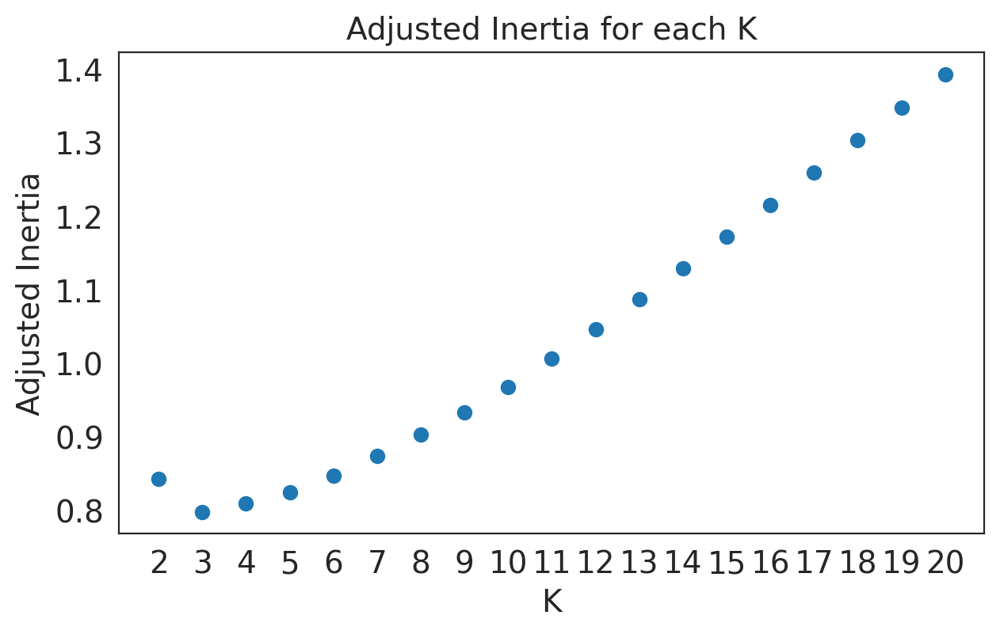

The optimal number of clusters is 3
Performing k-means clustering with 3 target clusters
Creating tissue_ID images for image objects...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 48 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  38 | elapsed:    0.8s remaining:    9.1s
[Parallel(n_jobs=-1)]: Done   7 out of  38 | elapsed:    1.5s remaining:    6.4s
[Parallel(n_jobs=-1)]: Done  11 out of  38 | elapsed:    8.6s remaining:   21.1s
[Parallel(n_jobs=-1)]: Done  15 out of  38 | elapsed:    9.3s remaining:   14.3s
[Parallel(n_jobs=-1)]: Done  19 out of  38 | elapsed:    9.6s remaining:    9.6s
[Parallel(n_jobs=-1)]: Done  23 out of  38 | elapsed:    9.9s remaining:    6.5s
[Parallel(n_jobs=-1)]: Done  27 out of  38 | elapsed:   10.0s remaining:    4.1s
[Parallel(n_jobs=-1)]: Done  31 out of  38 | elapsed:   12.0s remaining:    2.7s
[Parallel(n_jobs=-1)]: Done  35 out of  38 | elapsed:   12.2s remaining:    1.0s
[Parallel(n_jobs=-1)]: Done  38 out of  38 | elapsed:   12.4s finished


In [16]:
tl.label_tissue_regions(alpha = 0.05)

In [15]:
from MILWRM.ST import *

In [30]:
image_df['Img'][0].split('/')[-1].split('_downsampled')[0]

'HTA11_10167_0000_01_01_ADJ_region_001'

In [33]:
plt.rcParams["font.size"] = 10

/home/kaurh5/git/MILWRM/MILWRM/ST.py:876: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=figsize)


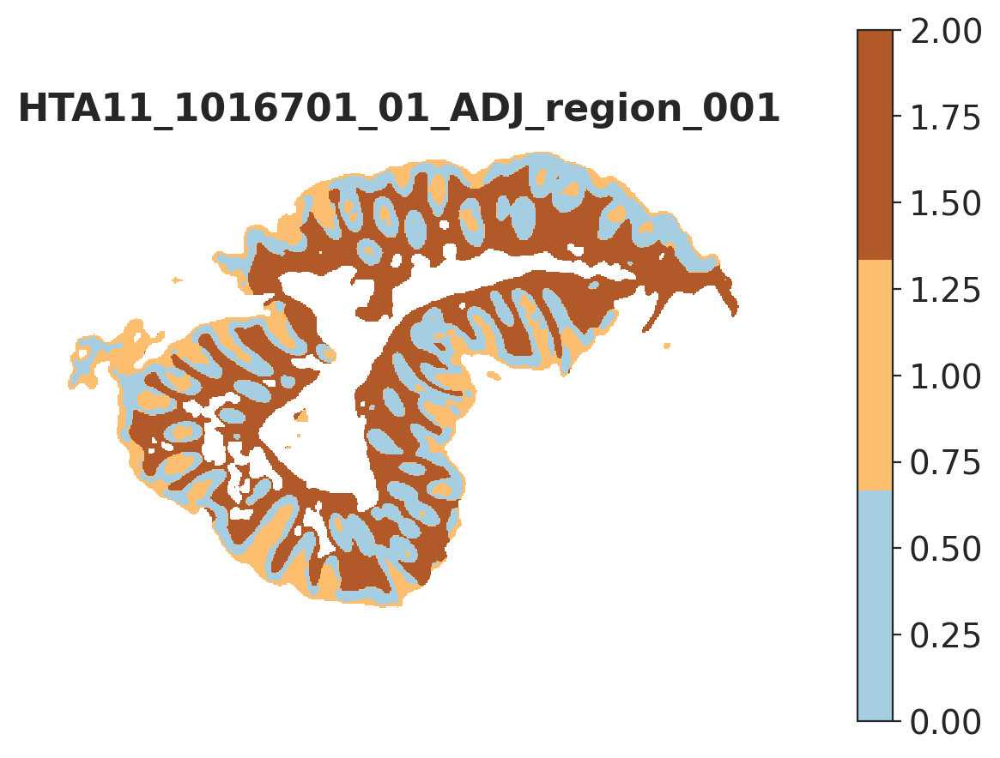

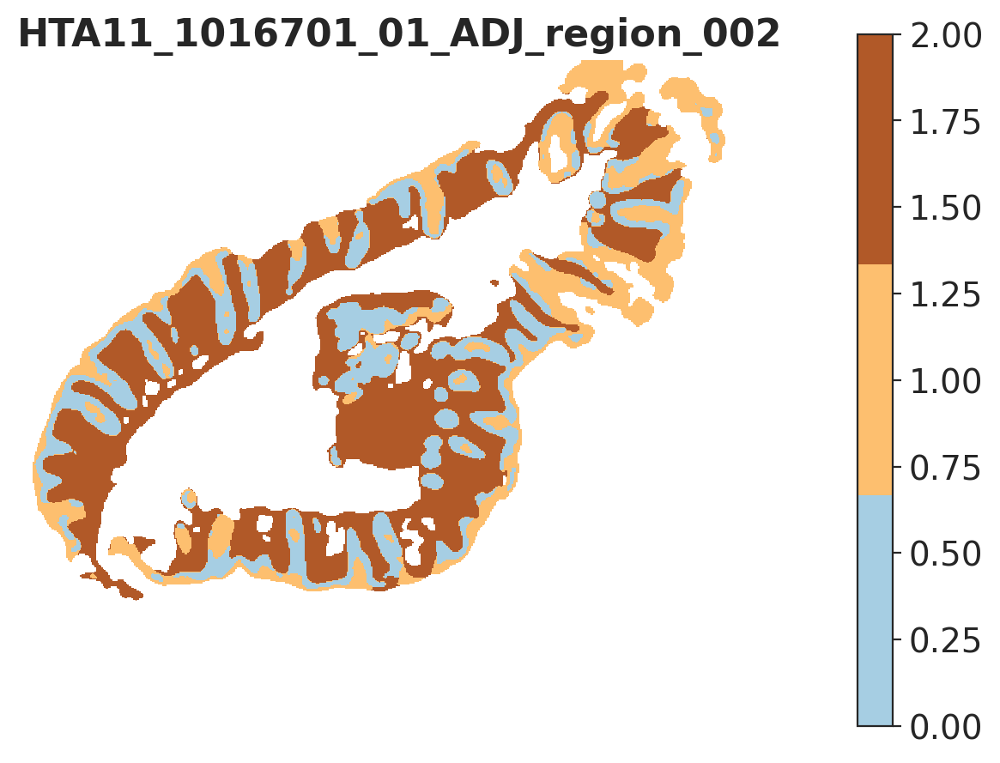

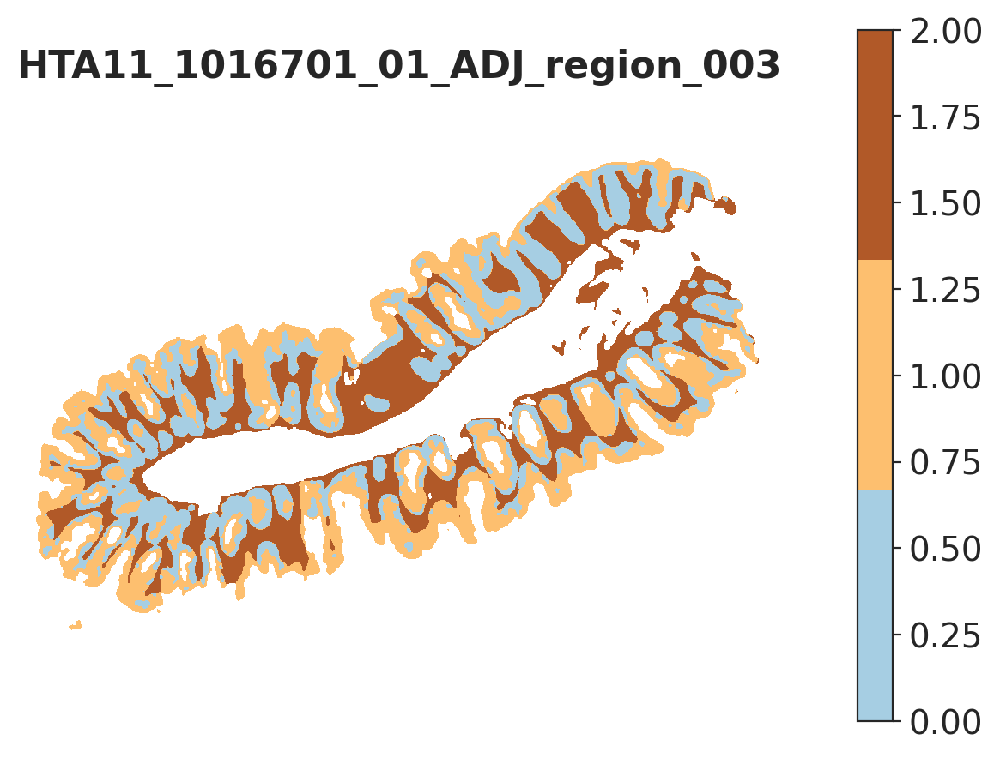

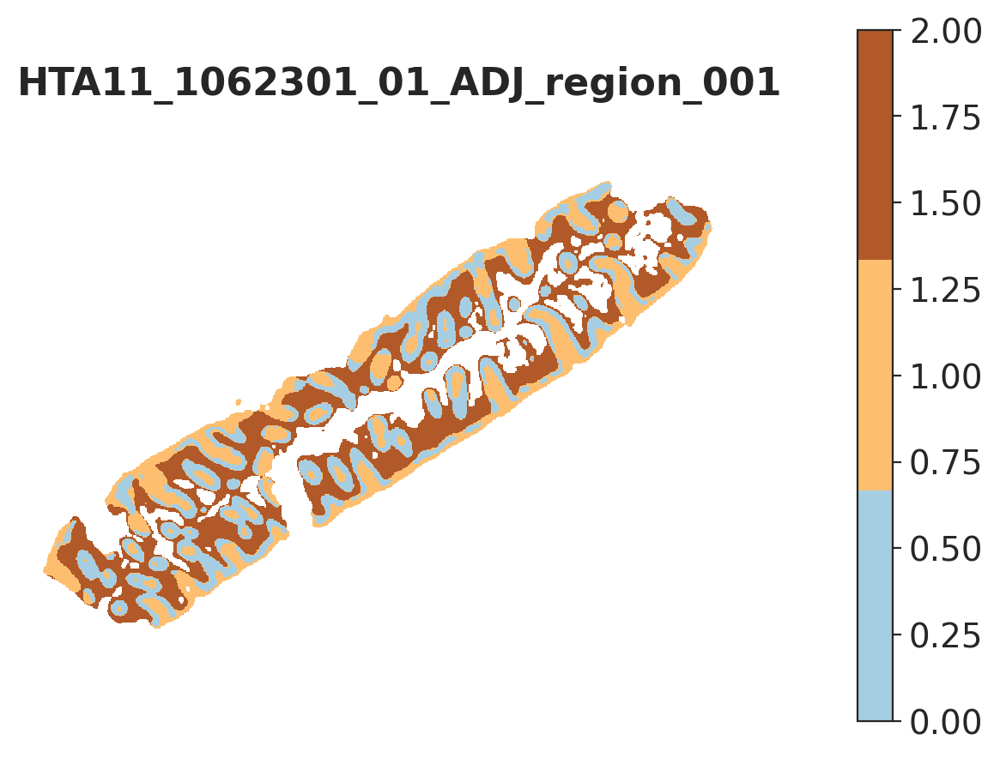

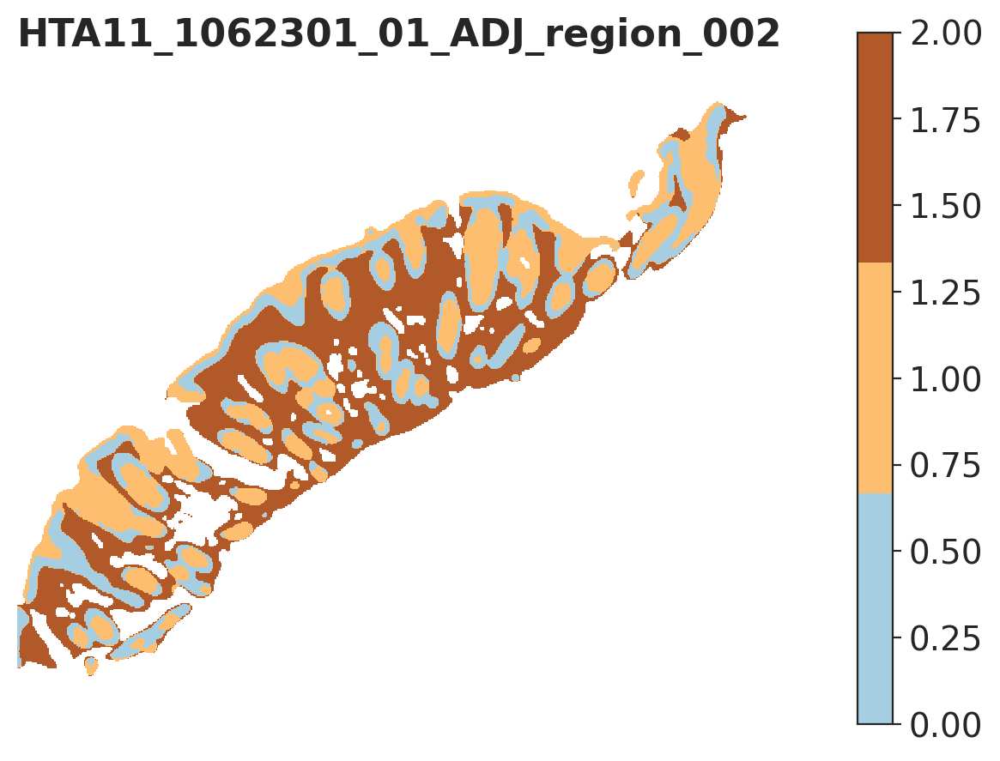

...

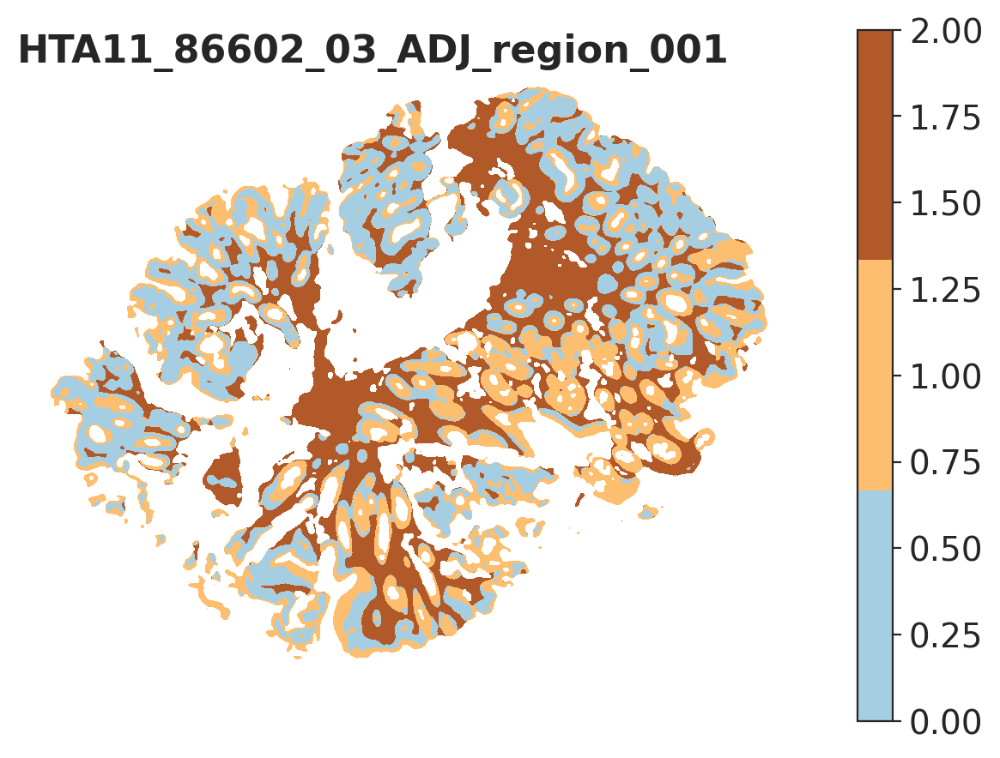

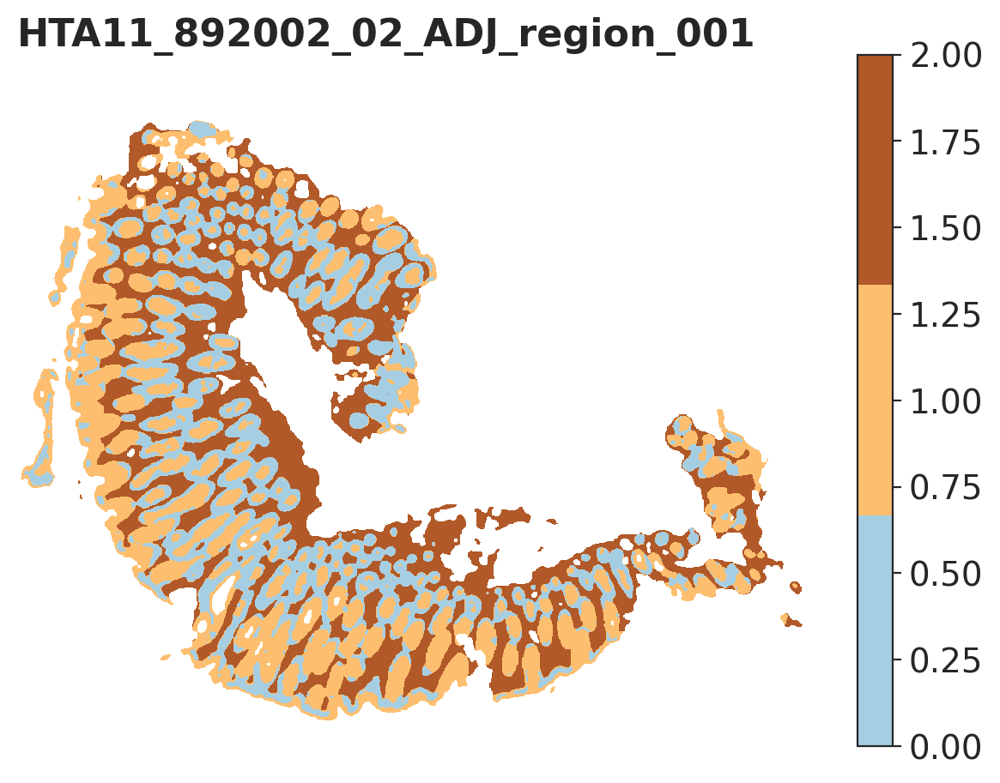

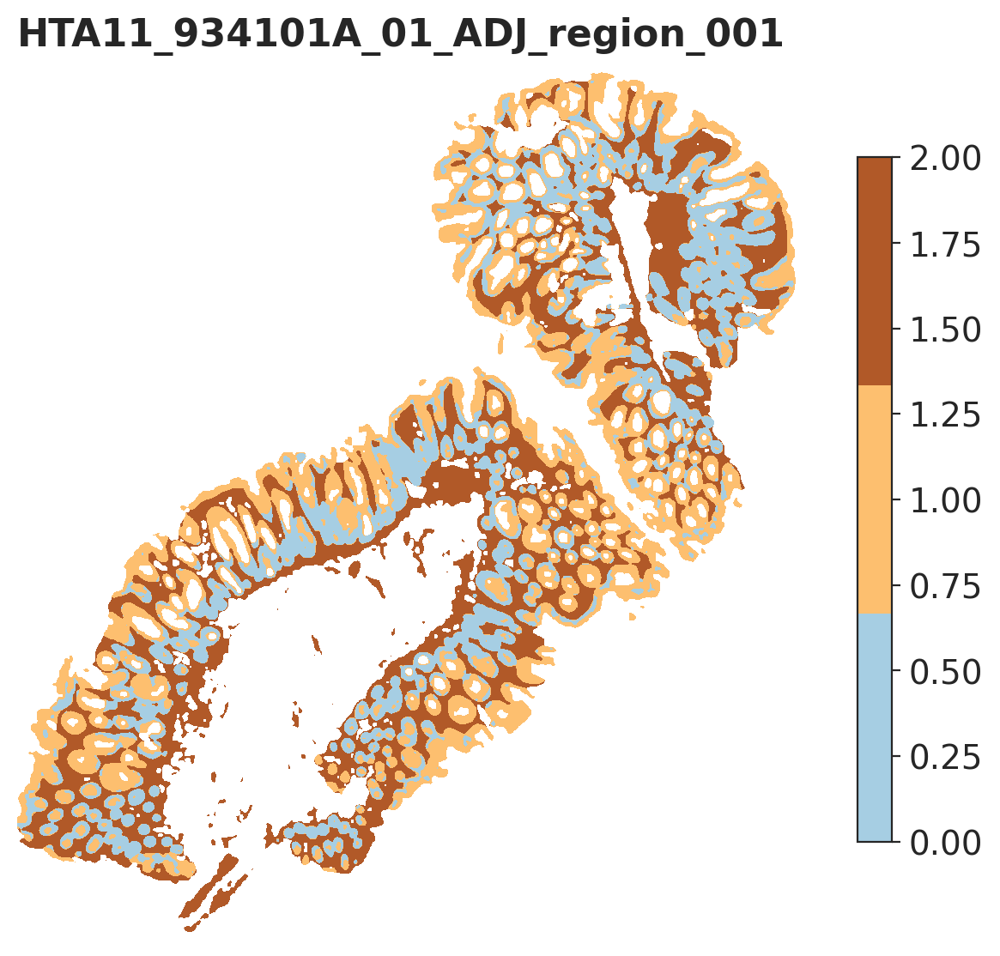

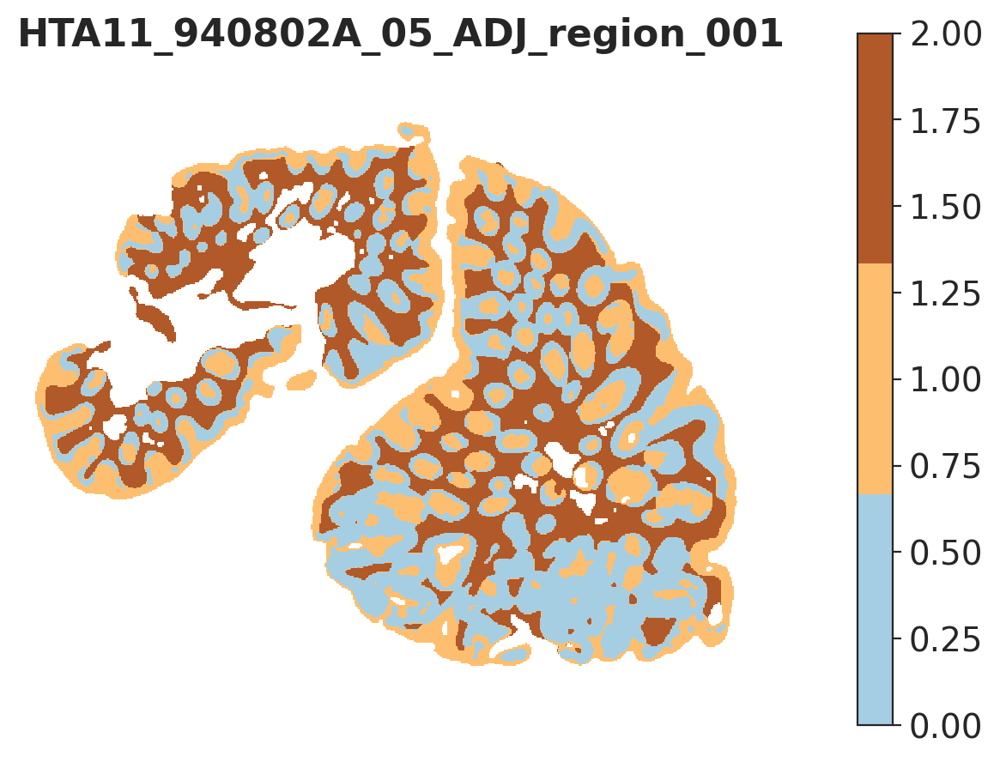

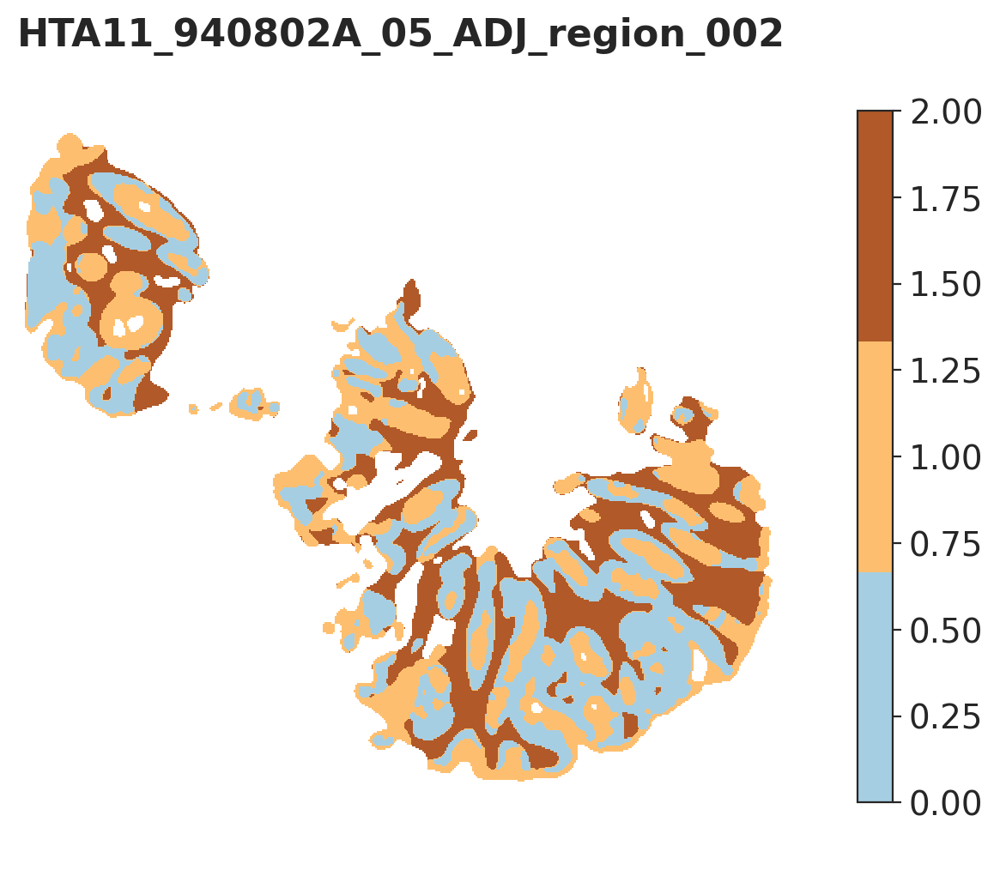

In [64]:
for i in range(len(tl.tissue_IDs)):
    cmap = plt.cm.get_cmap('Paired',3)
    p = show_pita(tl.tissue_IDs[i], figsize=(6,6), cmap=cmap, save_to='Figures/SupplementaryFig/FigS2B_' + str(i) + '.png', label = image_df['Img'][i].split('/')[-1].split('_downsampled')[0].replace('_0000_', ''))

Saving feature loadings to Figures/Fig2C.png


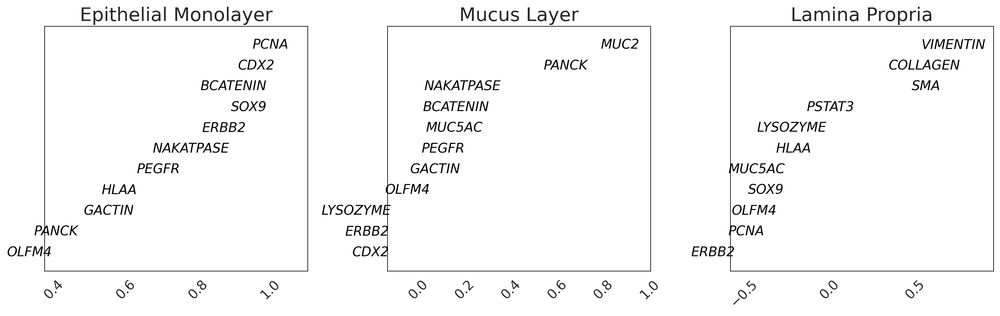

In [26]:
tl.plot_feature_loadings(nfeatures=10,titles = ['Epithelial Monolayer', 'Mucus Layer', 'Lamina Propria'], save_to="Figures/Fig2C.png")

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8920_0000_02_02_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_866_0000_02_03_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_

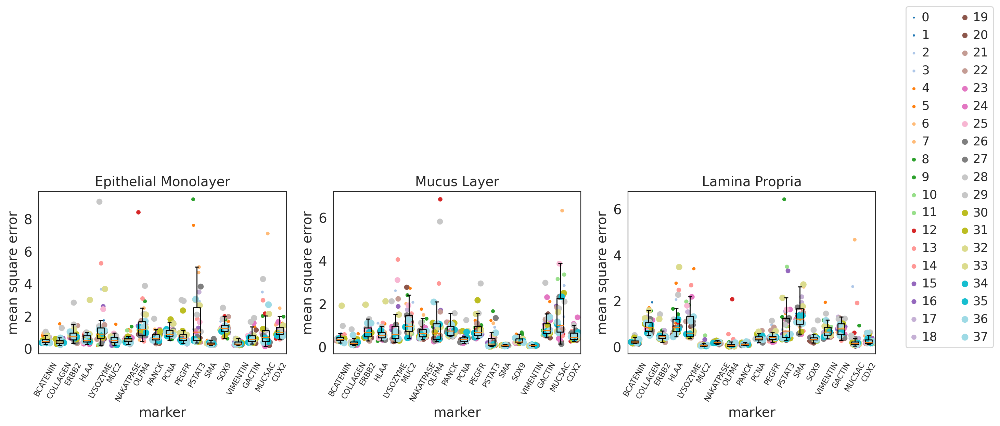

In [28]:
a = tl.plot_mse_mxif(titles = ['Epithelial Monolayer', 'Mucus Layer', 'Lamina Propria'], save_to="Figures/Fig2D.png")

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atl

<Figure size 500x500 with 0 Axes>

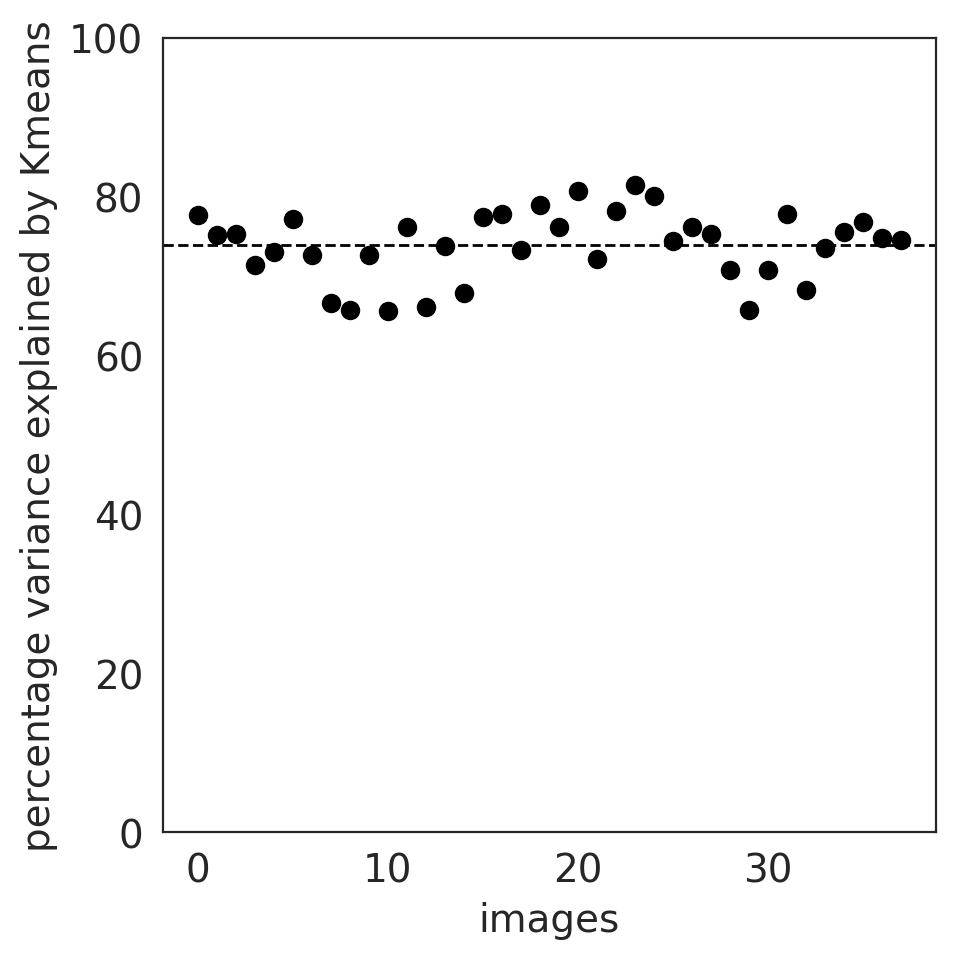

In [29]:
a = tl.plot_percentage_variance_explained(R_square= True, save_to= "Figures/Fig2B.png")

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_9408_0000_02A_05_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8622_0000_01E_01_ADJ_region_005_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8622_0000_01E_01_ADJ_region_004_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_9408_0000_02A_05_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8622_0000_01E_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8920_0000_02_02_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atla

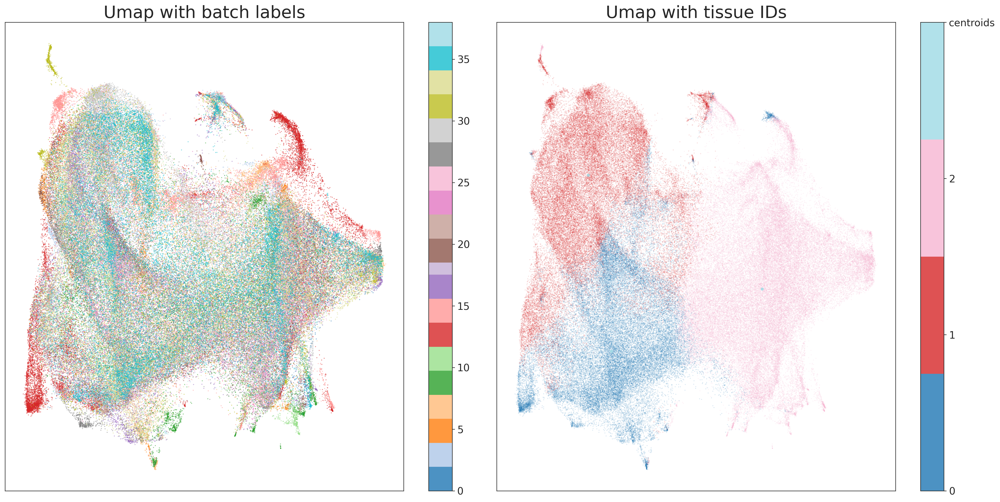

In [16]:
a = tl.make_umap(frac = 0.2, save_to='Figures/umap.png')

In [17]:
tl.confidence_score_images()

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atl

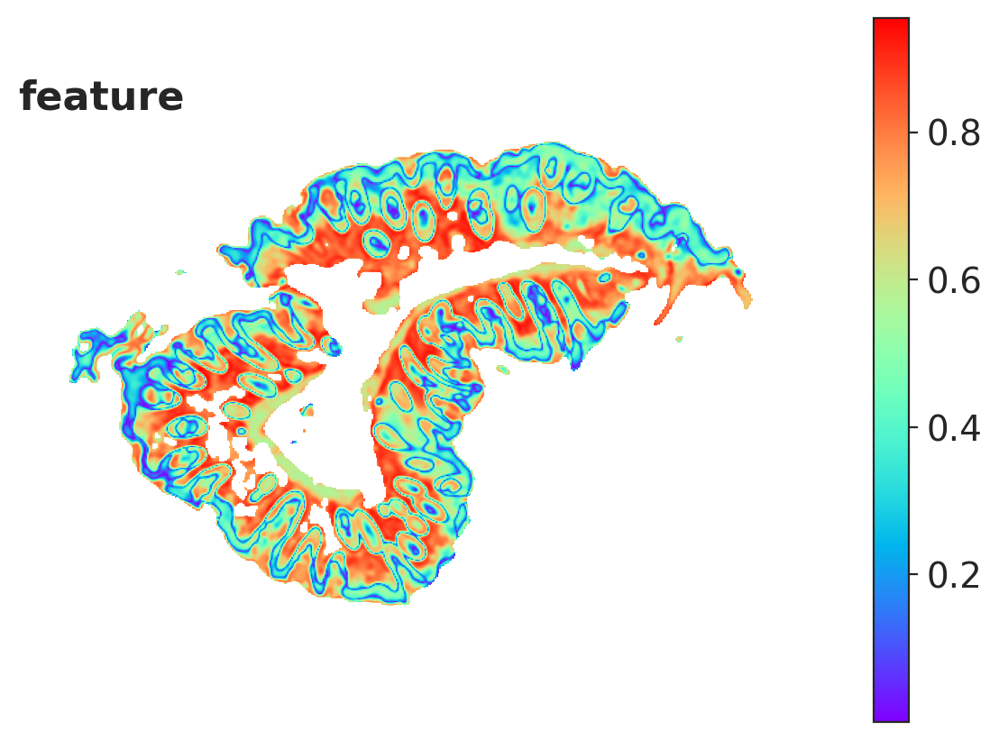

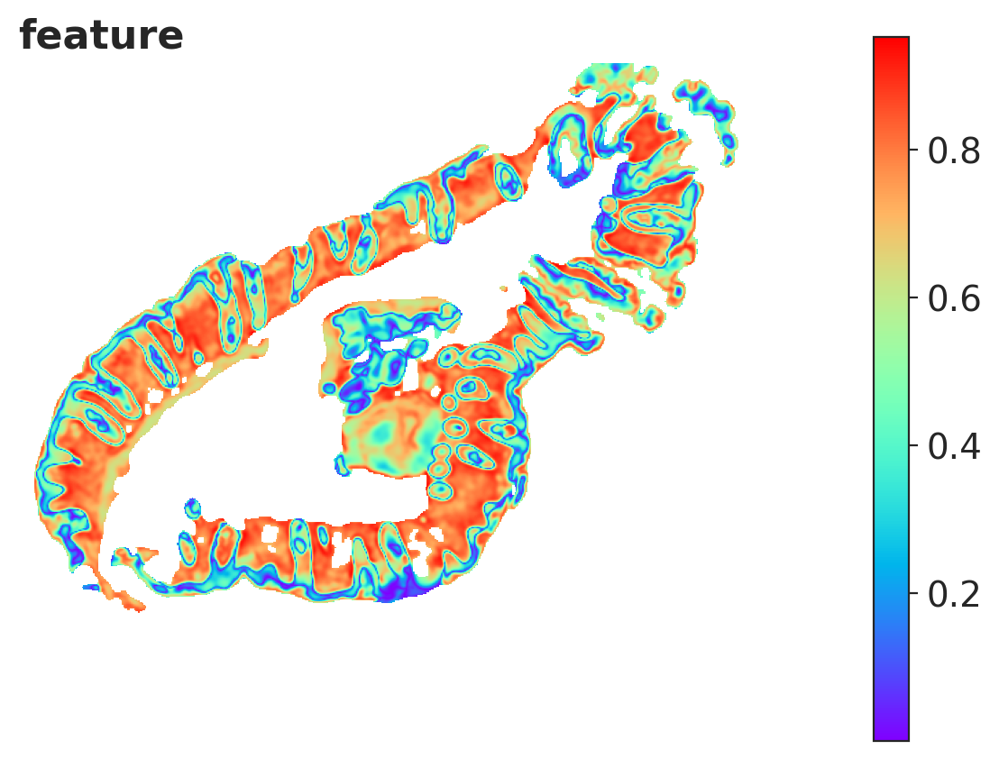

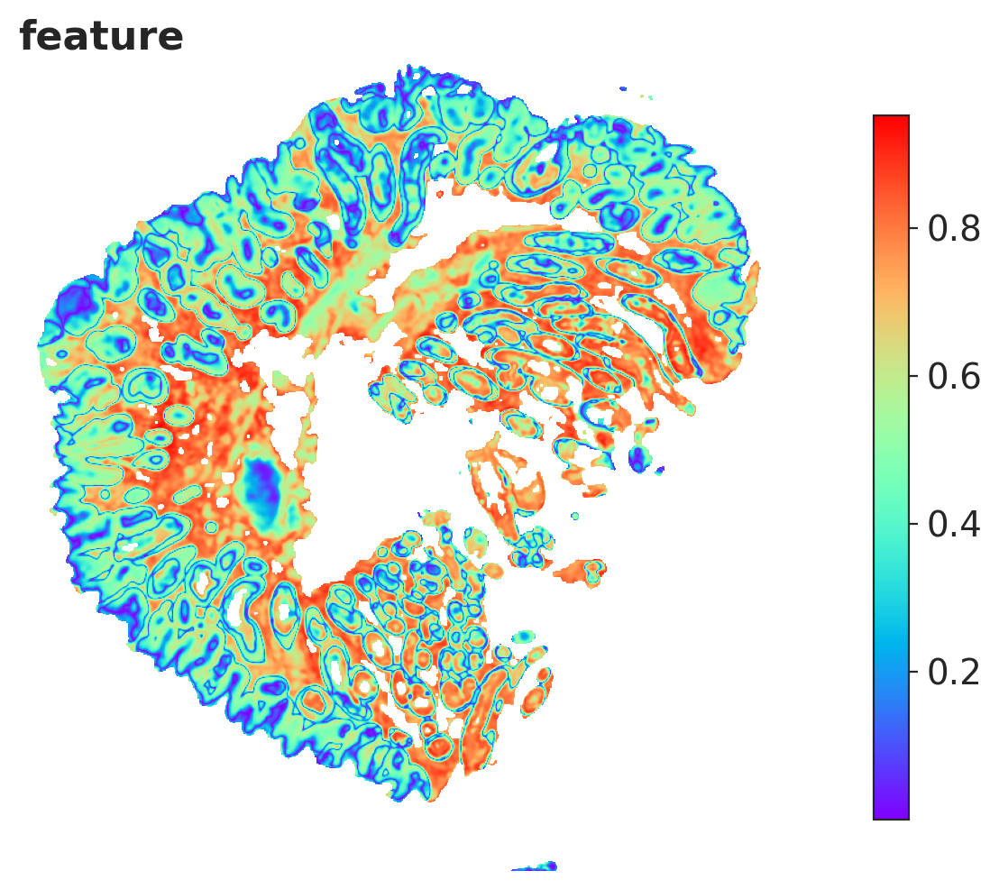

In [34]:
for i in [0,1,12]:
    p = show_pita(tl.confidence_IDs[i], figsize=(6,6), cmap='rainbow', save_to='Figures/Fig2E_' + str(i) + '.png')

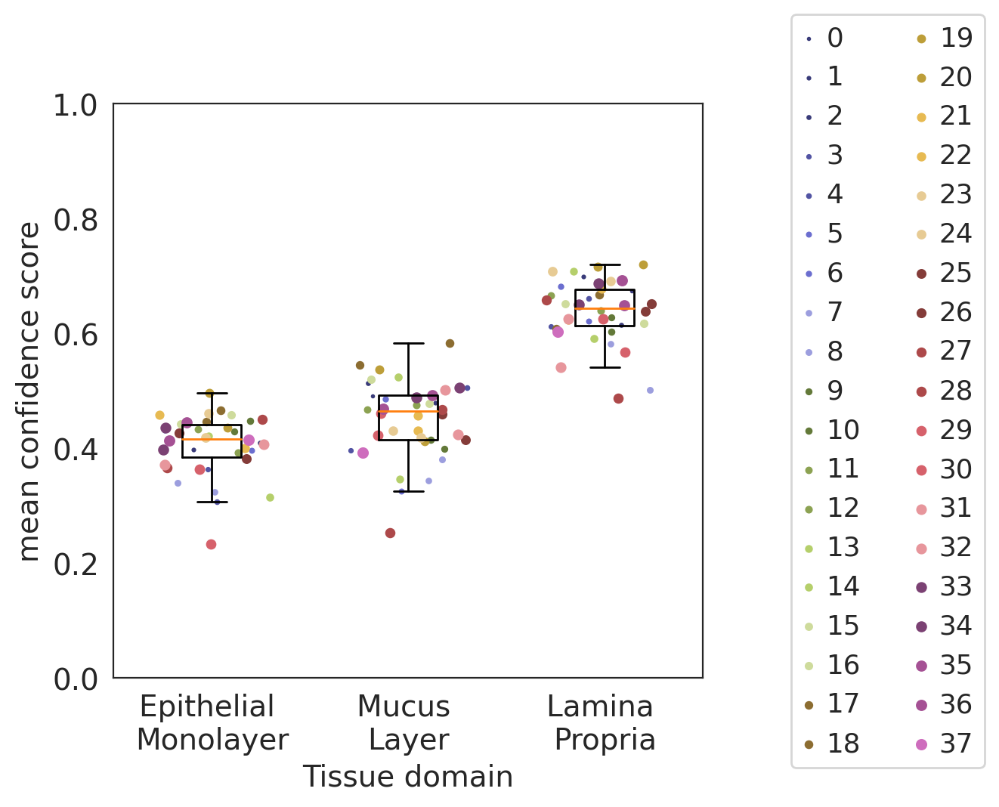

In [18]:
fig = plt.subplots(figsize = (5,5))
colors = plt.cm.tab20b(np.linspace(0,1.0,42))
plt.boxplot(tl.confidence_score_df, positions=range(3), showfliers=False)
plt.xticks(ticks = range(3), labels = ['Epithelial \nMonolayer', 'Mucus \nLayer', 'Lamina \nPropria'], ha = 'center')
for col in tl.confidence_score_df:
    for k in range(len(tl.tissue_IDs)):
        dots = plt.scatter(col, tl.confidence_score_df[col][k], s = 1 + k*0.5, color = colors[k],label = str(k) if col == 0 else "")
        offsets = dots.get_offsets()
        jittered_offsets = offsets
        jittered_offsets[:, 0] += np.random.uniform(
                        -0.3, 0.3, offsets.shape[0])
        dots.set_offsets(jittered_offsets)
    plt.legend(loc = 'right', bbox_to_anchor=(1.5,0.5), ncol = 2)
plt.ylim((0,1))
plt.xlabel('Tissue domain')
plt.ylabel('mean confidence score')
plt.savefig('Figures/mean_confidence_score_005.png', dpi = 300)

In [19]:
df_count = pd.DataFrame()
for i in range(len(tl.tissue_IDs)):
    unique,counts = np.unique(tl.tissue_IDs[i], return_counts=True)
    dict_ = dict(zip(unique,counts))
    n_counts = []
    for k in range(tl.k):
        if k not in dict_.keys():
            n_counts.append(0)
        else:
            n_counts.append(dict_[k])
    df = pd.DataFrame(n_counts, columns = [i])
    df_count = pd.concat([df_count,df], axis = 1)

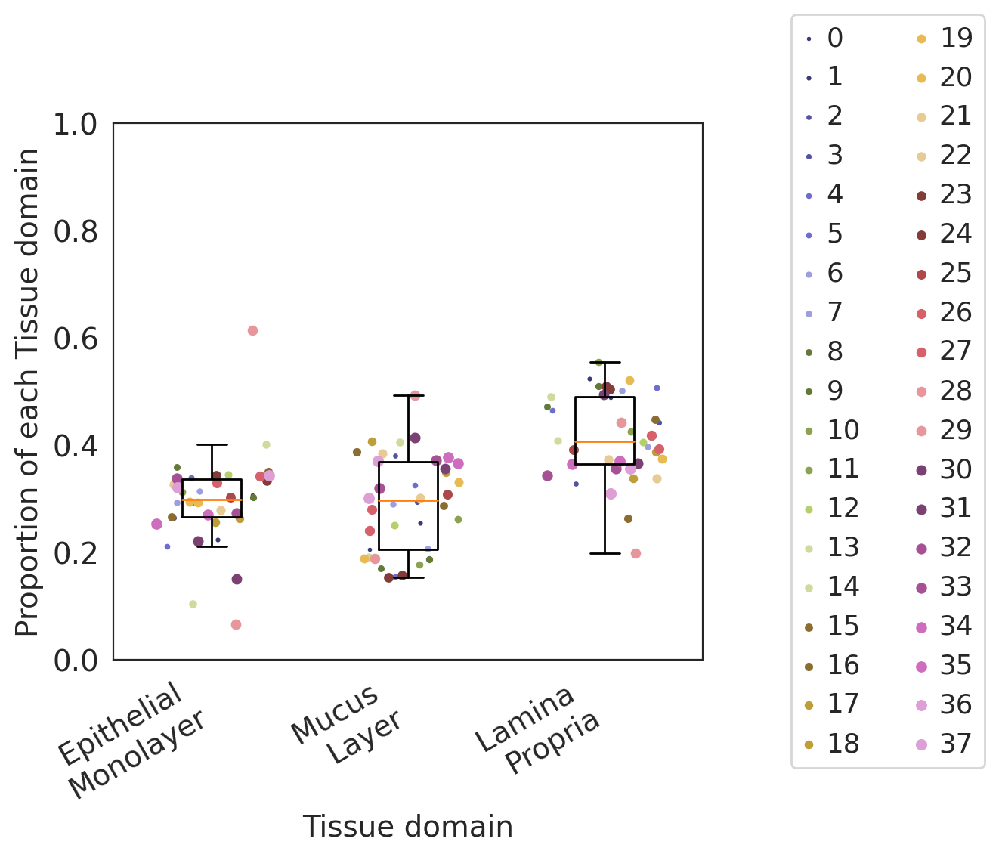

In [20]:
fig = plt.figure(figsize = (5,5))
color = plt.cm.tab20b(np.linspace(0,1,len(tl.tissue_IDs)))
df_count = df_count / df_count.sum()
plt.boxplot(df_count.T, positions=range(3), showfliers=False)
plt.xticks(ticks = range(3), labels = ['Epithelial \nMonolayer', 'Mucus \nLayer', 'Lamina \nPropria'], ha = 'center')
for col in df_count.T:
    for k in range(len(tl.tissue_IDs)):
        dots = plt.scatter(col, df_count.T[col][k], s = 1 + k*0.5,color = color[k],label = str(k) if col == 0 else "")
        offsets = dots.get_offsets()
        jittered_offsets = offsets
        jittered_offsets[:, 0] += np.random.uniform(
                        -0.3, 0.3, offsets.shape[0])
        dots.set_offsets(jittered_offsets)
    plt.legend(loc = 'right', bbox_to_anchor=(1.5,0.5), ncol = 2)
fig.autofmt_xdate()
plt.ylim((0,1))
plt.xlabel('Tissue domain')
plt.ylabel('Proportion of each Tissue domain')
plt.savefig('Figures/tID_proportion_005.png', dpi = 300)

### alpha = 0.02

Determining optimal cluster number k via scaled inertia


[Parallel(n_jobs=37)]: Using backend LokyBackend with 37 concurrent workers.
[Parallel(n_jobs=37)]: Done   2 out of  19 | elapsed:   46.6s remaining:  6.6min
[Parallel(n_jobs=37)]: Done   4 out of  19 | elapsed:   52.7s remaining:  3.3min
[Parallel(n_jobs=37)]: Done   6 out of  19 | elapsed:  1.3min remaining:  2.8min
[Parallel(n_jobs=37)]: Done   8 out of  19 | elapsed:  1.6min remaining:  2.2min
[Parallel(n_jobs=37)]: Done  10 out of  19 | elapsed:  1.9min remaining:  1.7min
[Parallel(n_jobs=37)]: Done  12 out of  19 | elapsed:  2.0min remaining:  1.1min
[Parallel(n_jobs=37)]: Done  14 out of  19 | elapsed:  2.5min remaining:   53.9s
[Parallel(n_jobs=37)]: Done  16 out of  19 | elapsed:  2.7min remaining:   30.5s
[Parallel(n_jobs=37)]: Done  19 out of  19 | elapsed:  3.0min finished


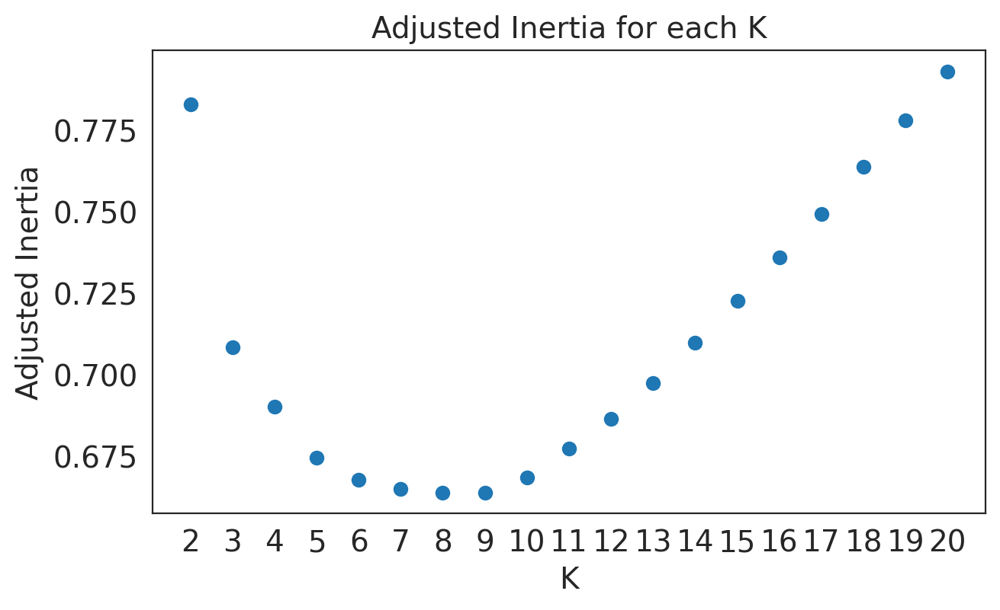

The optimal number of clusters is 9
Performing k-means clustering with 9 target clusters
Creating tissue_ID images for image objects...


[Parallel(n_jobs=37)]: Using backend LokyBackend with 37 concurrent workers.
[Parallel(n_jobs=37)]: Done   5 out of  38 | elapsed:    1.1s remaining:    7.3s
[Parallel(n_jobs=37)]: Done   9 out of  38 | elapsed:    1.4s remaining:    4.4s
[Parallel(n_jobs=37)]: Done  13 out of  38 | elapsed:    1.5s remaining:    2.9s
[Parallel(n_jobs=37)]: Done  17 out of  38 | elapsed:    1.8s remaining:    2.2s
[Parallel(n_jobs=37)]: Done  21 out of  38 | elapsed:    8.8s remaining:    7.1s
[Parallel(n_jobs=37)]: Done  25 out of  38 | elapsed:    9.3s remaining:    4.9s
[Parallel(n_jobs=37)]: Done  29 out of  38 | elapsed:    9.6s remaining:    3.0s
[Parallel(n_jobs=37)]: Done  33 out of  38 | elapsed:    9.7s remaining:    1.5s
[Parallel(n_jobs=37)]: Done  38 out of  38 | elapsed:    9.9s finished


In [15]:
tl.label_tissue_regions(alpha = 0.02, n_jobs=37)

/home/kaurh5/git/MILWRM/MILWRM/ST.py:876: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=figsize)


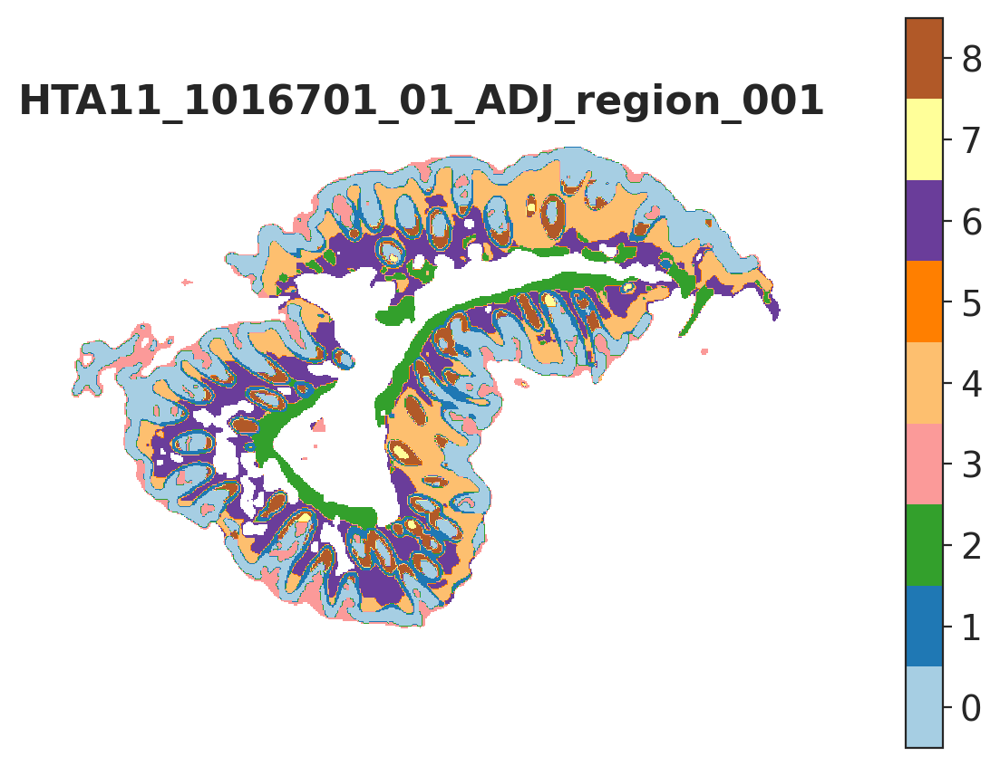

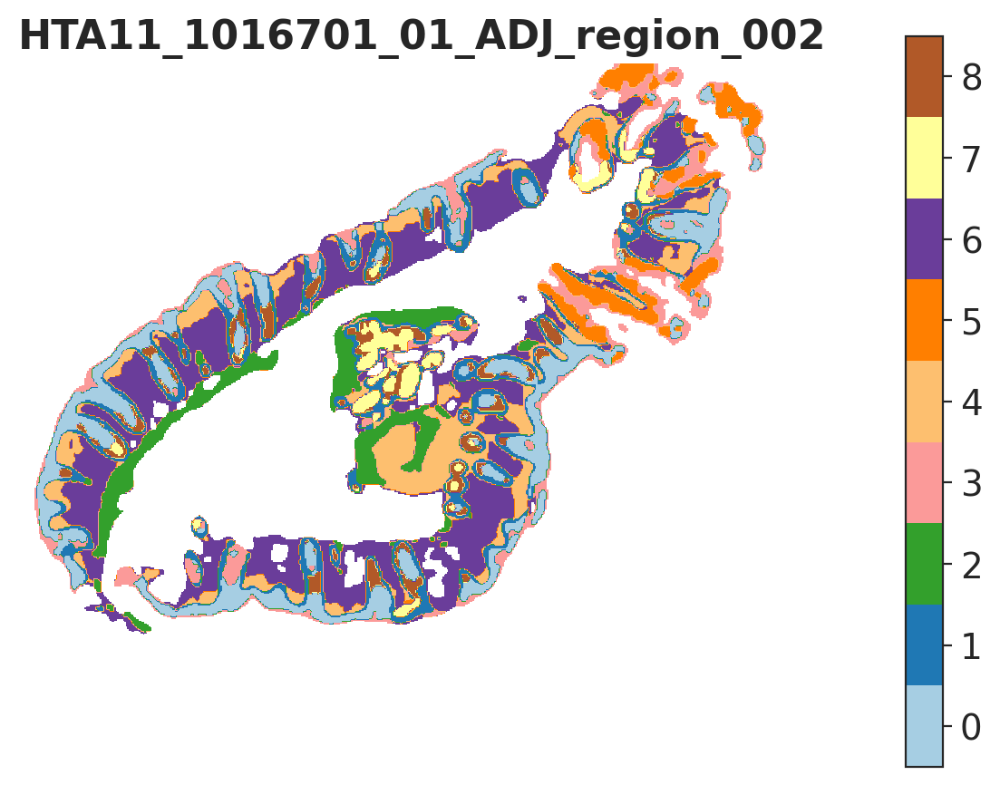

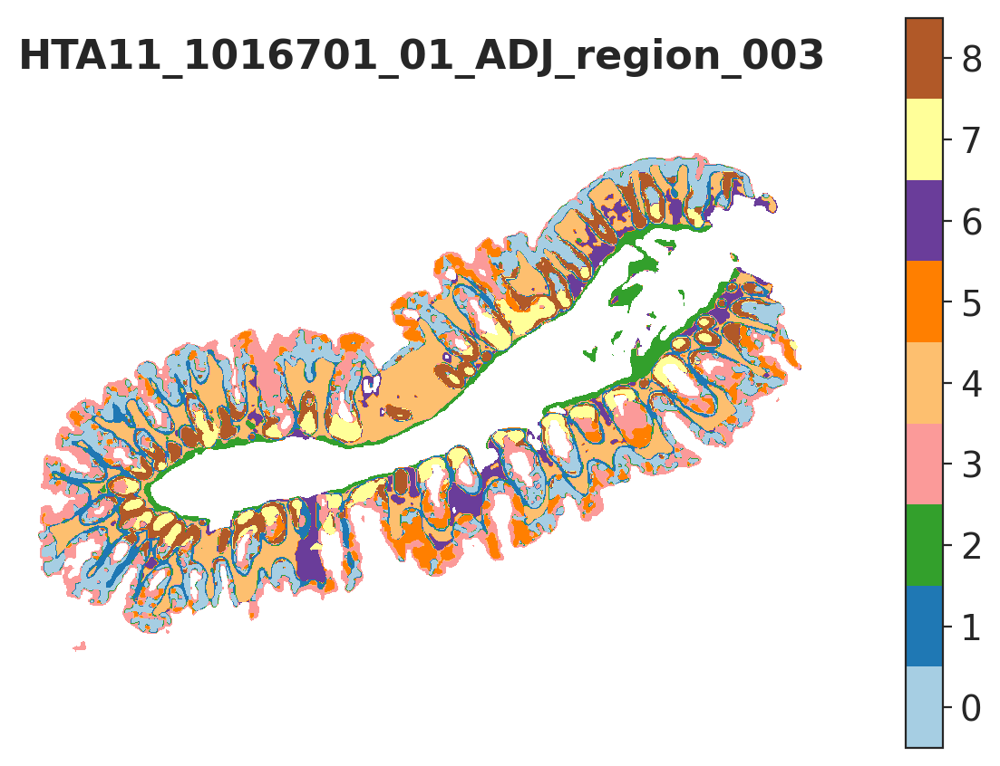

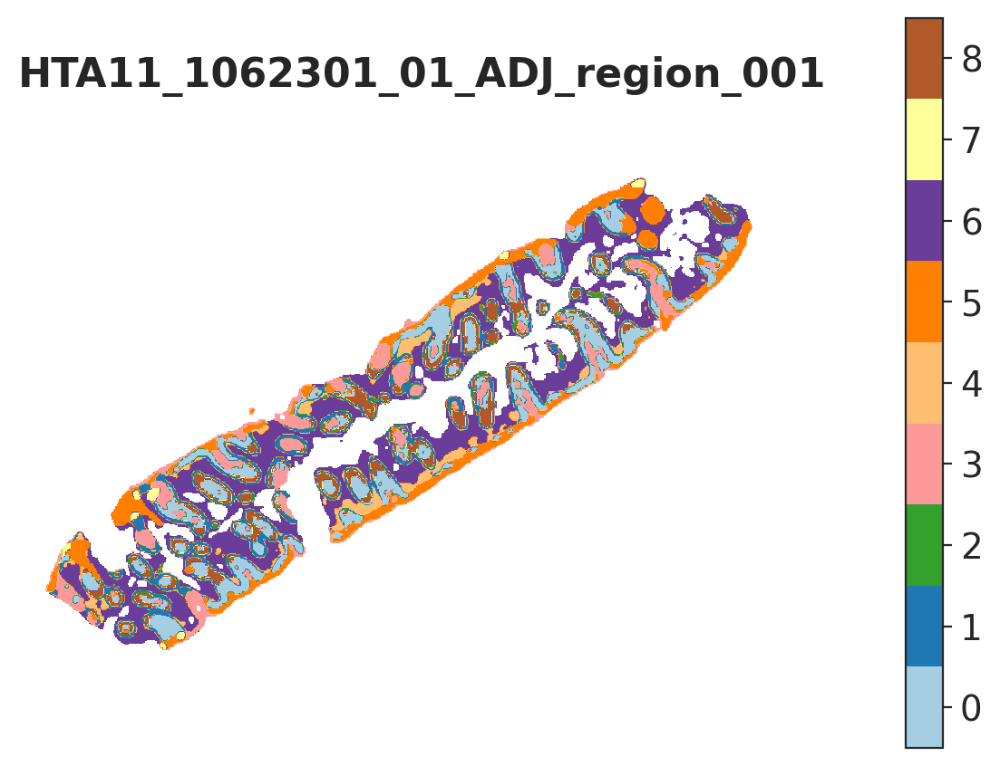

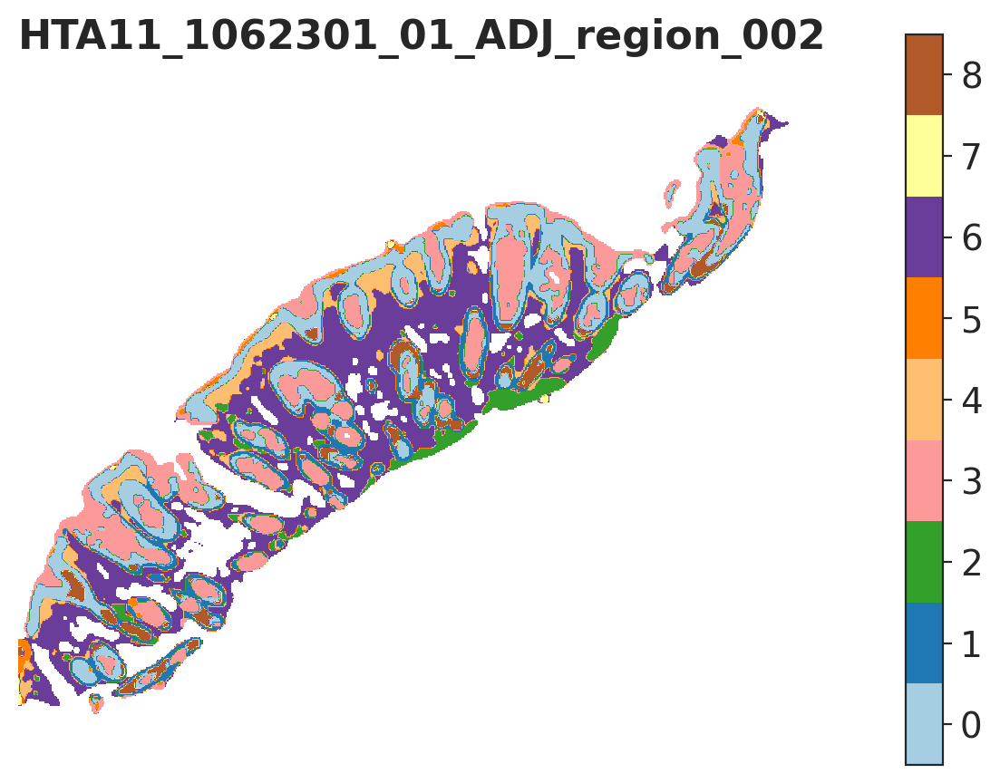

...

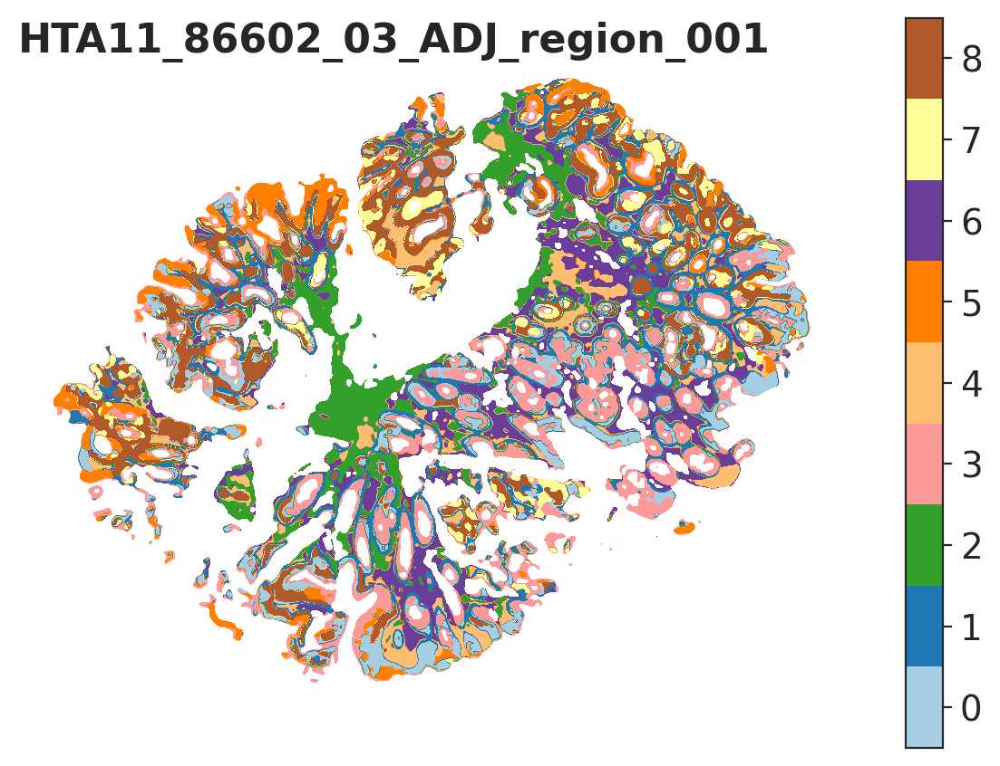

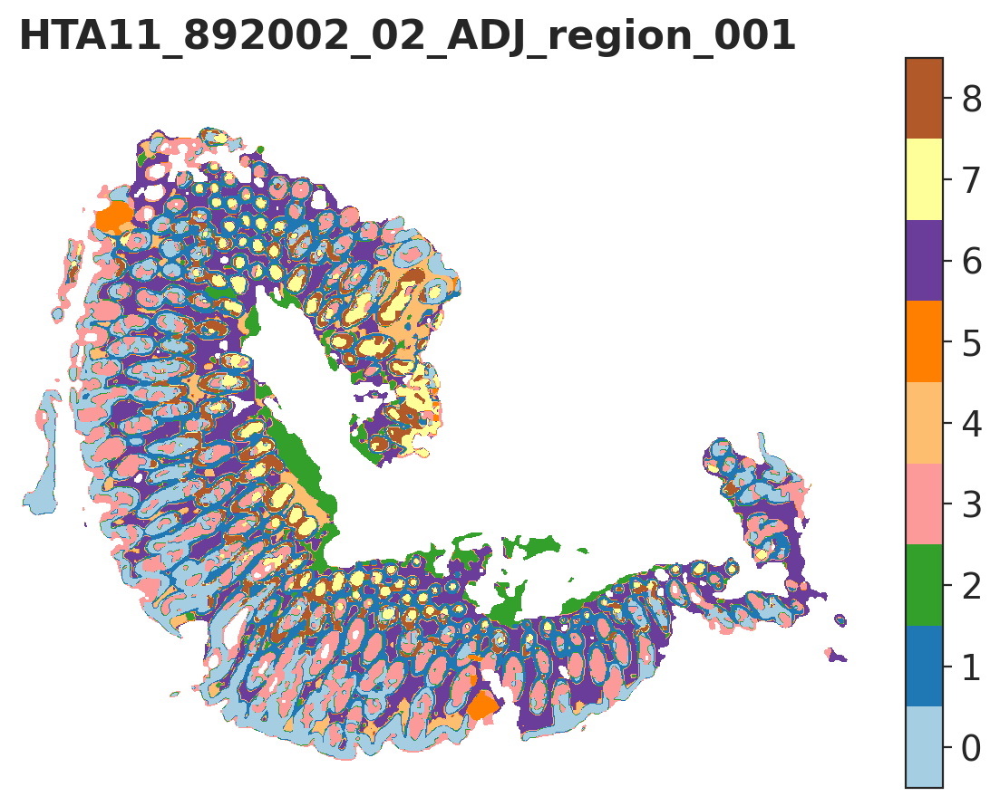

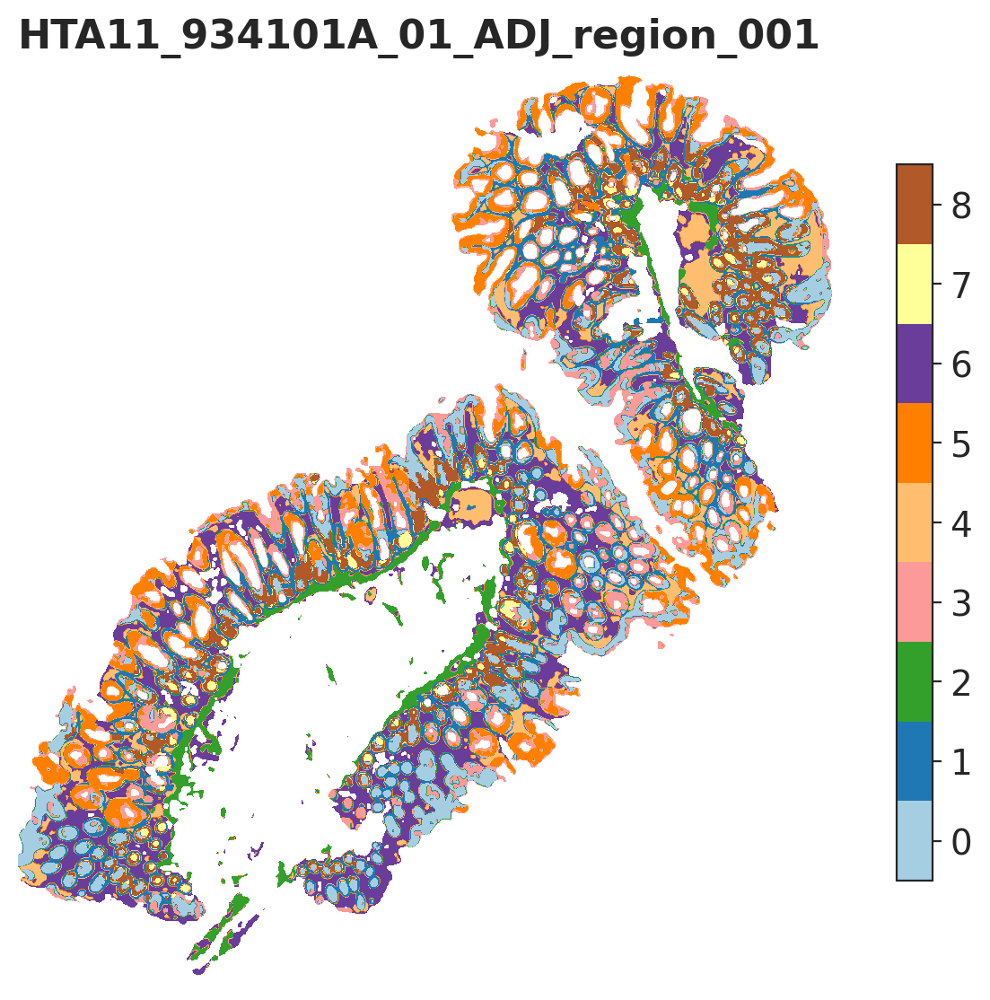

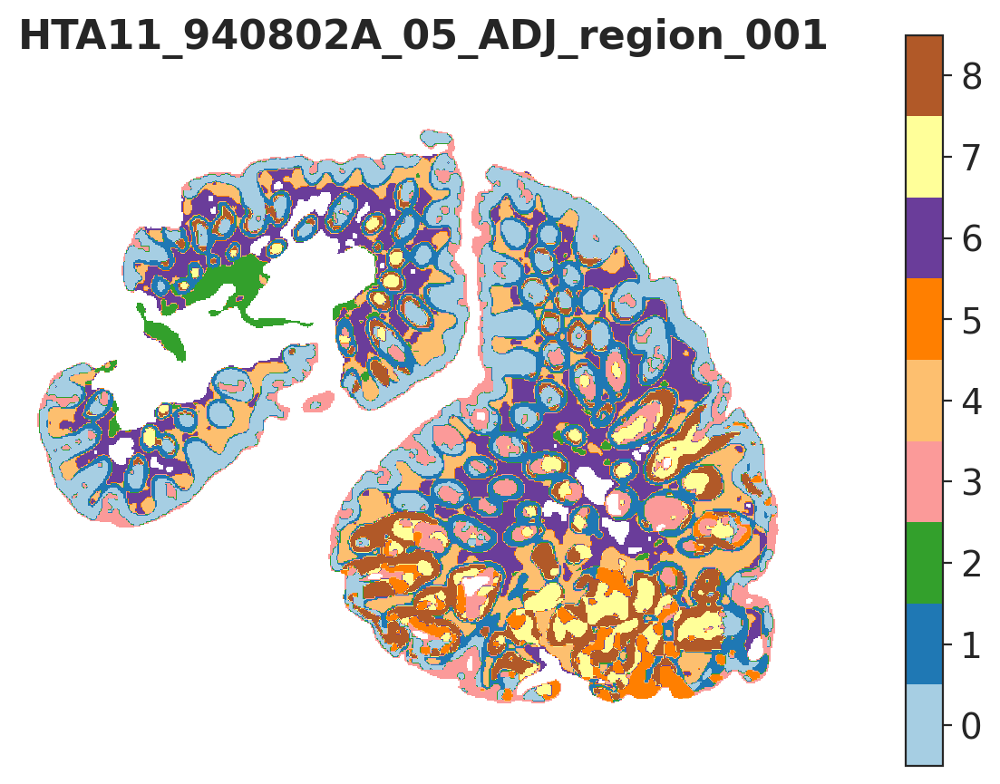

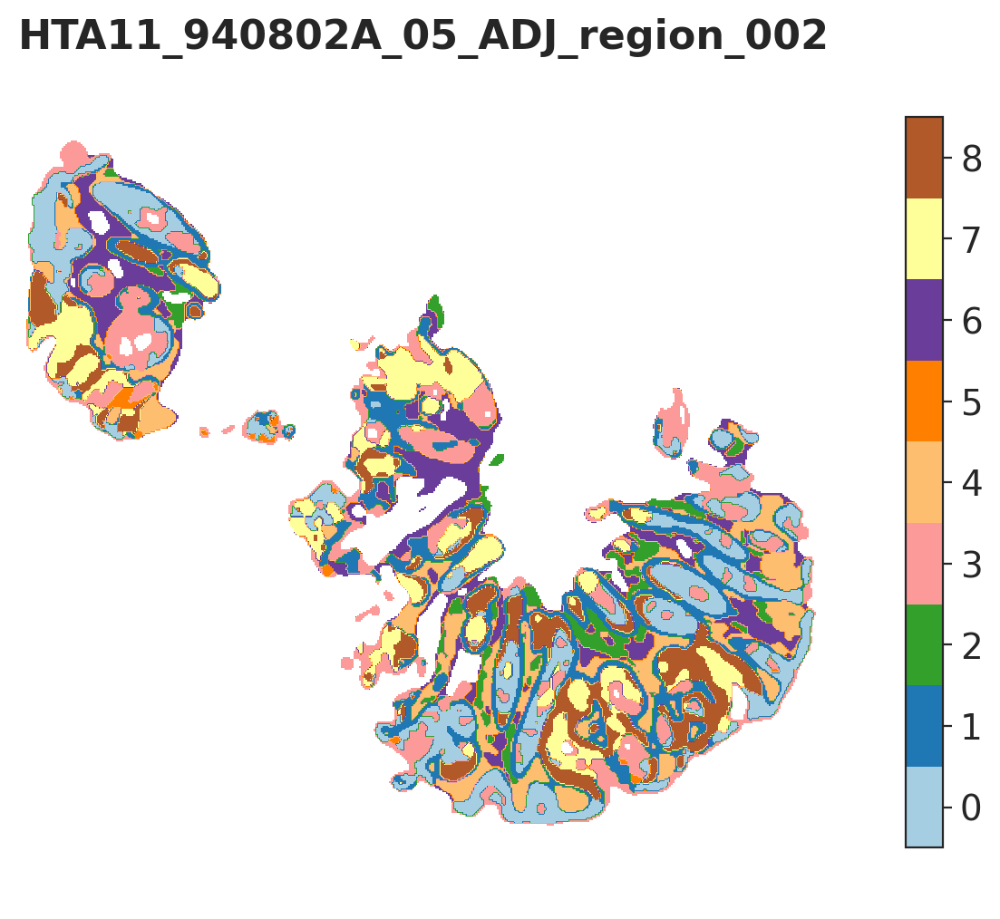

In [62]:
for i in range(len(tl.tissue_IDs)):
    cmap = plt.cm.get_cmap('Paired',9)
    p = show_pita(tl.tissue_IDs[i], figsize=(6,6), cmap=cmap, vmax = 8.5, vmin = -0.5 , save_to= 'Figures/SupplementaryFig/FigS2A_' + str(i) + '.png', label = image_df['Img'][i].split('/')[-1].split('_downsampled')[0].replace('_0000_', ''))

In [16]:
tissue_ID_labels = ['Differentiated', 'Pericryptal Stroma', 'Smooth Muscle', 'Mucus', 'Proximal Lamina Propria' , 'Abnormal Layer','Deep Lamina Propria', 'Crypt Lumen','Stem Layer']

GridSpec(3, 3)

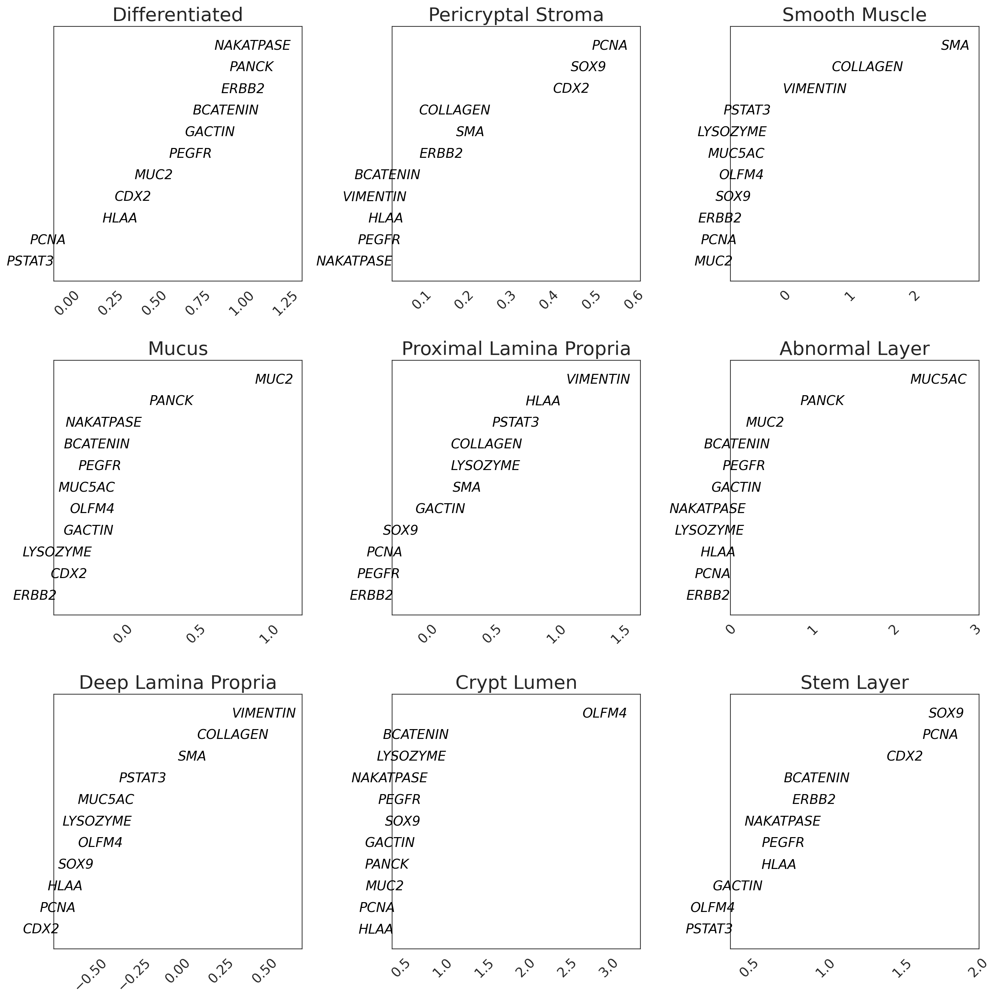

In [27]:
tl.plot_feature_loadings(nfeatures=10, ncols = 3, titles= ['Differentiated', 'Pericryptal Stroma', 'Smooth Muscle', 'Mucus', 'Proximal Lamina Propria' , 'Abnormal Layer','Deep Lamina Propria', 'Crypt Lumen','Stem Layer']
                        , save_to= None)

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atl

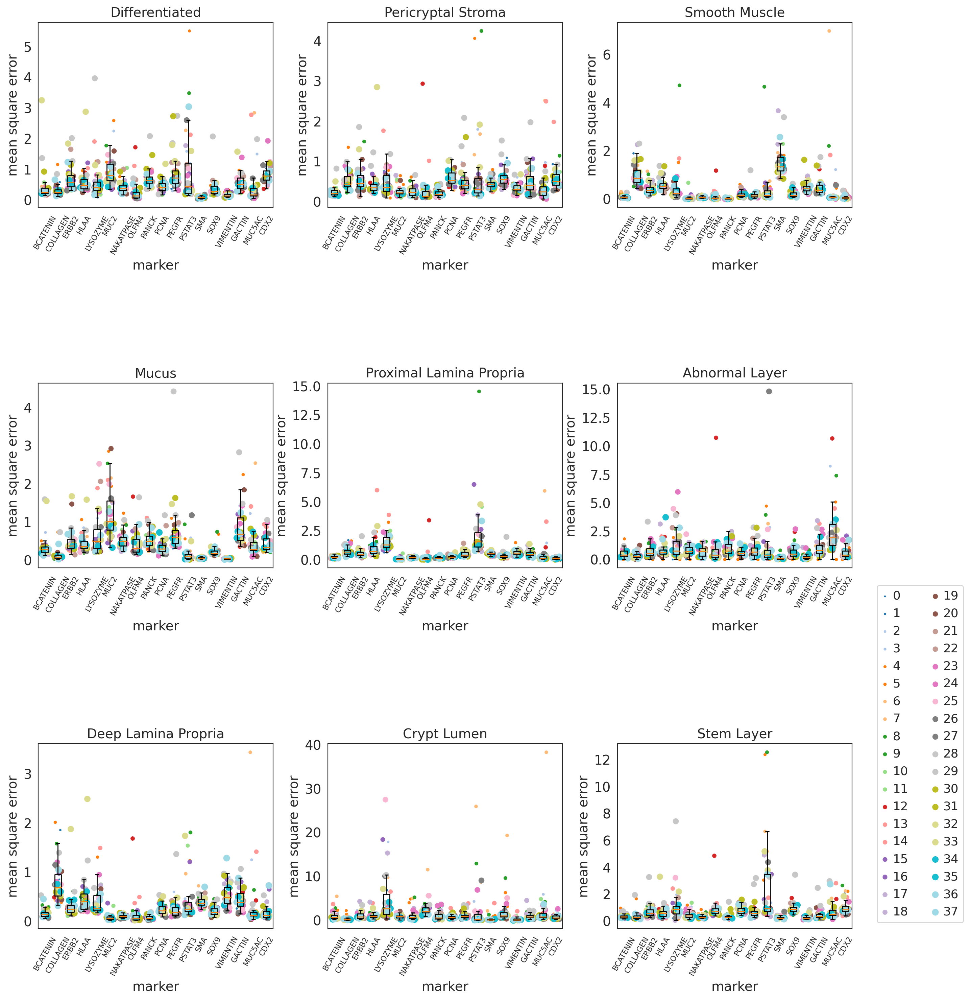

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8622_0000_01E_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_7956_0000_02_05_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8099_0000_02_01_ADJ_region_005_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_7956_0000_02_05_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_9408_0000_02A_05_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_8622_0000_01E_01_ADJ_region_005_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_

In [17]:
a = tl.plot_mse_mxif(ncols= 3, titles= tissue_ID_labels, save_to= 'Figures/FigS3.png')

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atl

<Figure size 500x500 with 0 Axes>

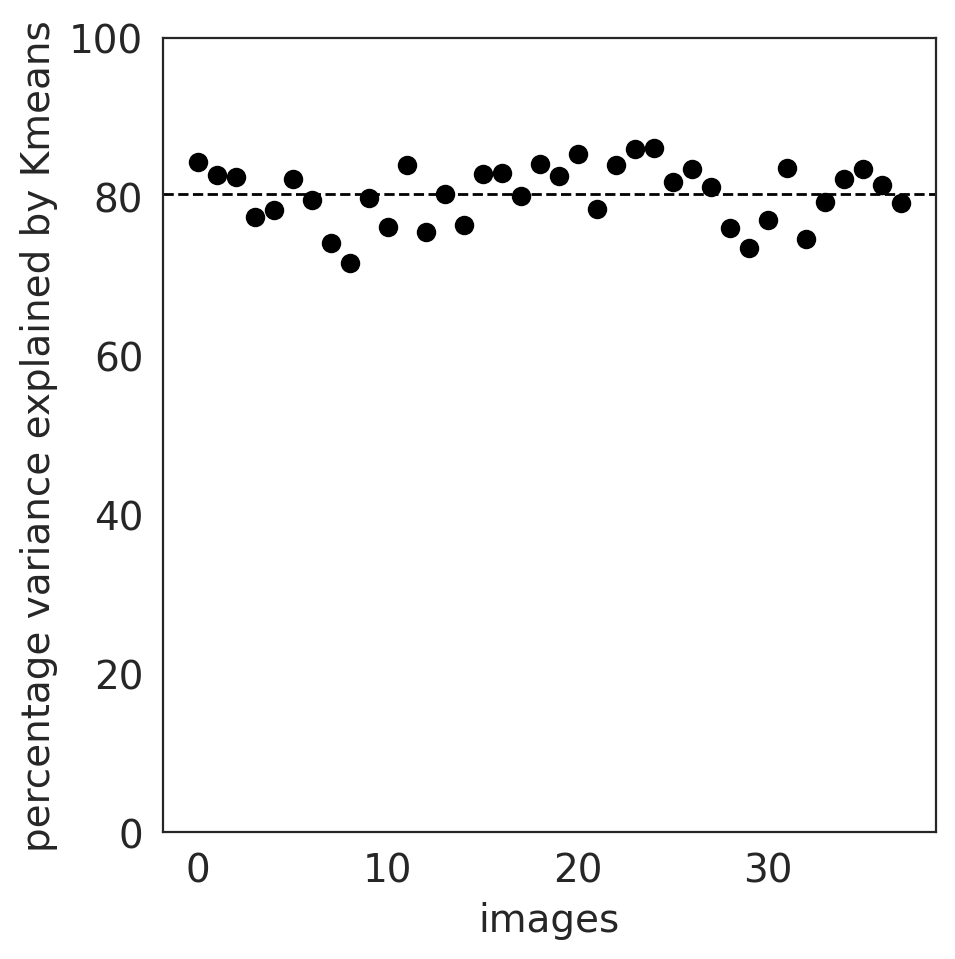

In [70]:
a = tl.plot_percentage_variance_explained(R_square= True, save_to= 'Figures/S31.png')

In [23]:
tl.confidence_score_images()

Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...


/home/kaurh5/anaconda3/envs/my_env/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/kaurh5/anaconda3/envs/my_env/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10167_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_003_downsampled_final_preprocessed.npz...


/home/kaurh5/anaconda3/envs/my_env/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/kaurh5/anaconda3/envs/my_env/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_004_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_005_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10623_0000_01_01_ADJ_region_006_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_10711_0000_01_01_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_4255_0000_02_02_ADJ_region_001_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas_mxif/BALANCED/_final_preprocessed_images/HTA11_4255_0000_02_02_ADJ_region_002_downsampled_final_preprocessed.npz...
Loading img object from /media/disk2/atlas

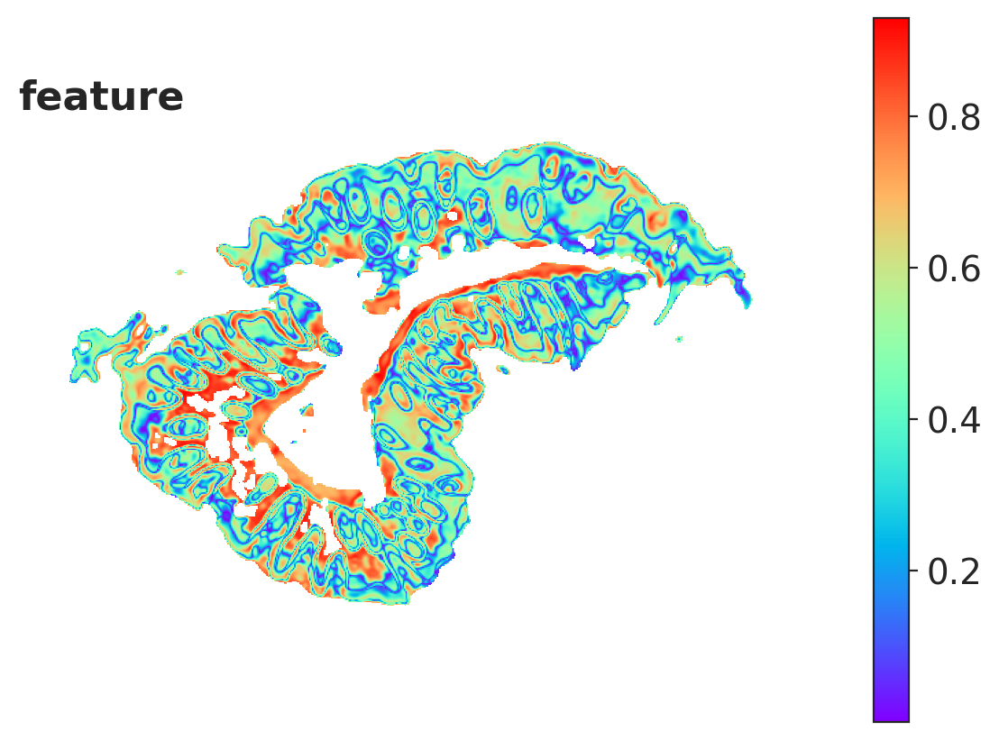

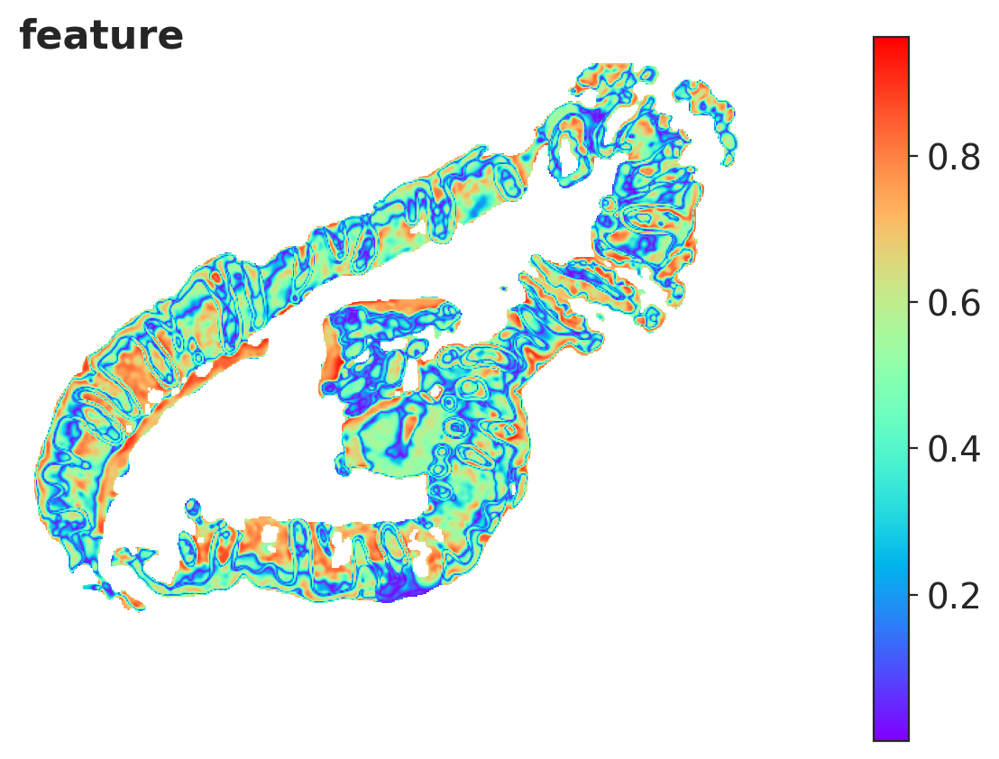

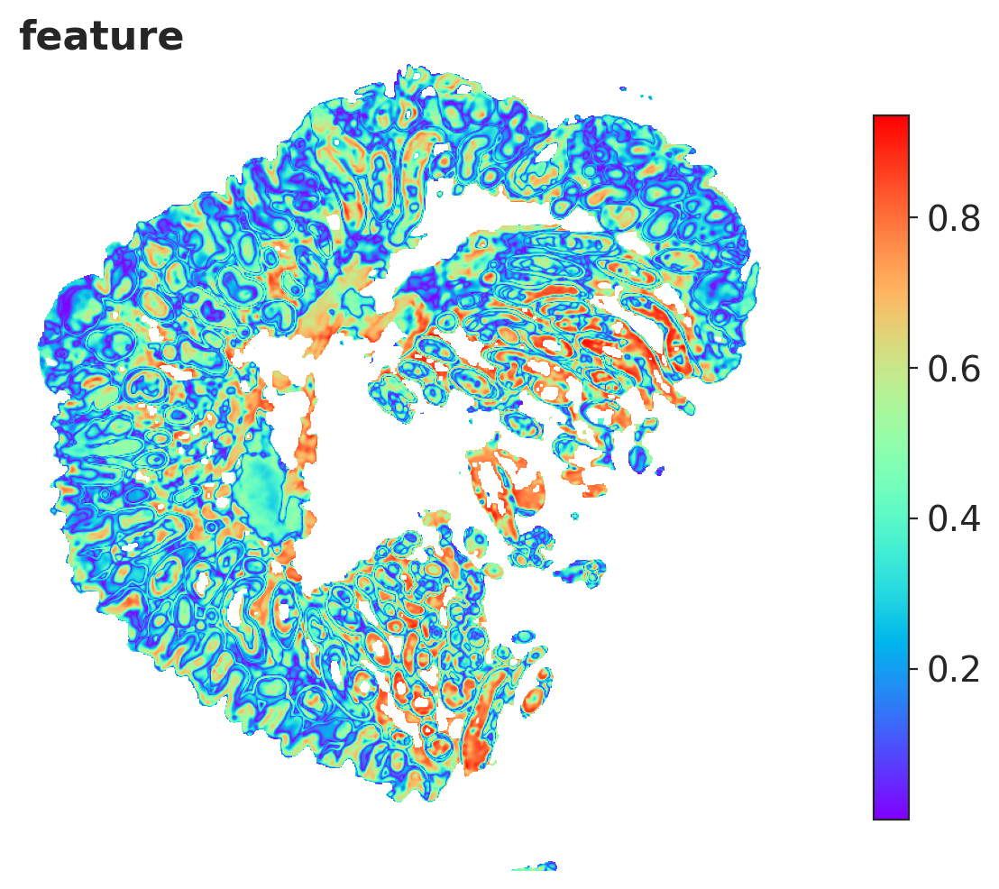

In [72]:
for i in [0,1,12]:
    p = show_pita(tl.confidence_IDs[i], figsize=(6,6), cmap='rainbow', save_to='Figures/FigS3II_' + str(i) + '.png')

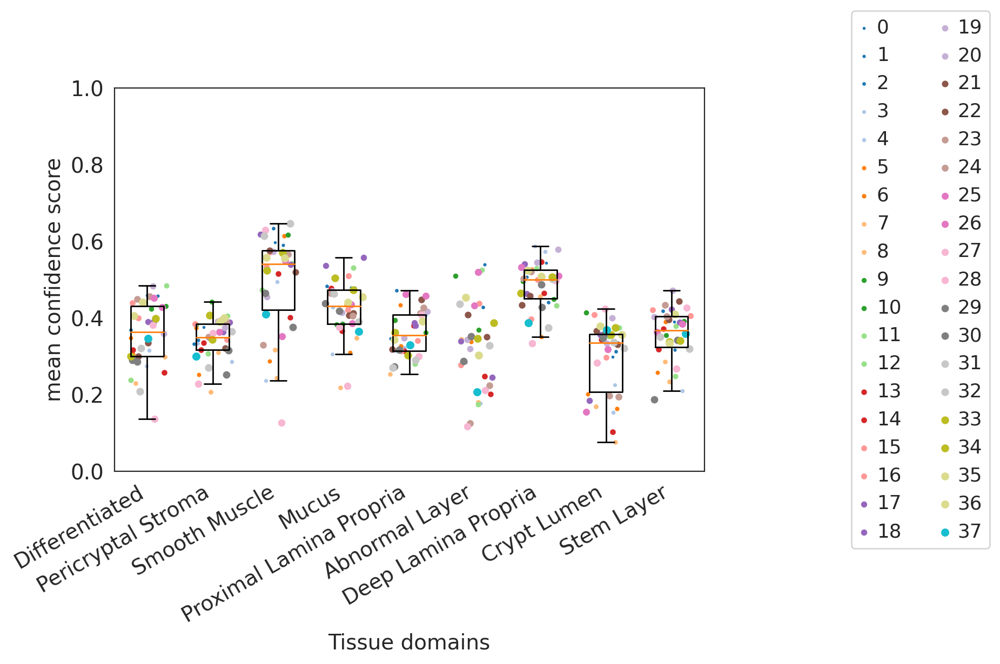

In [24]:
fig = plt.figure(figsize = (7,5))
colors = plt.cm.tab20(np.linspace(0,1.0,42))
plt.boxplot(tl.confidence_score_df, positions=list(range(tl.k)), showfliers=False)
plt.xticks(ticks = range(tl.k), labels = tissue_ID_labels)
for col in tl.confidence_score_df:
    for k in range(len(tl.tissue_IDs)):
        dots = plt.scatter(col, tl.confidence_score_df[col][k], s = 1 + k*0.5, color = colors[k],label = str(k) if col == 0 else "")
        offsets = dots.get_offsets()
        jittered_offsets = offsets
        # only jitter in the x-direction
        jittered_offsets[:, 0] += np.random.uniform(-0.3, 0.3, offsets.shape[0])
        dots.set_offsets(jittered_offsets)
    plt.legend(loc = 'right', bbox_to_anchor=(1.5,0.5), ncol = 2)
fig.autofmt_xdate()
plt.ylim((0,1))
plt.xlabel('Tissue domains')
plt.ylabel('mean confidence score')
plt.savefig('Figures/confscore_002.png', dpi = 300)

In [25]:
df_count = pd.DataFrame()
for i in range(len(tl.tissue_IDs)):
    unique,counts = np.unique(tl.tissue_IDs[i], return_counts=True)
    dict_ = dict(zip(unique,counts))
    n_counts = []
    for k in range(tl.k):
        if k not in dict_.keys():
            n_counts.append(0)
        else:
            n_counts.append(dict_[k])
    df = pd.DataFrame(n_counts, columns = [i])
    df_count = pd.concat([df_count,df], axis = 1)

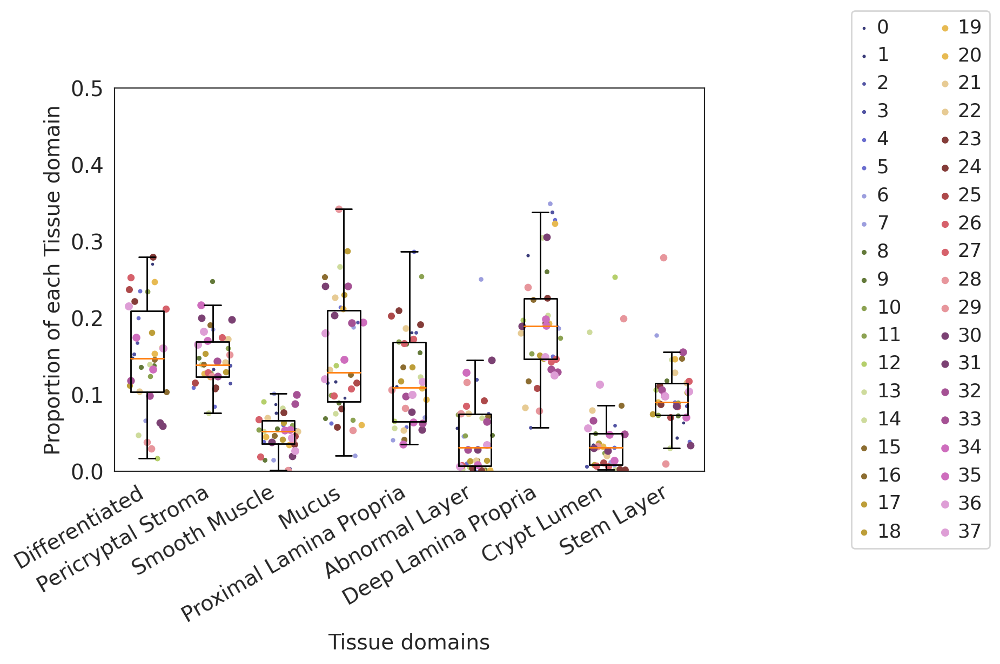

In [26]:
fig = plt.figure(figsize = (7,5))
color = plt.cm.tab20b(np.linspace(0,1,len(tl.tissue_IDs)))
df_count = df_count / df_count.sum()
plt.boxplot(df_count.T, positions=range(9), showfliers=False)
plt.xticks(ticks = range(tl.k), labels = tissue_ID_labels, rotation = 60)
for col in df_count.T:
    for k in range(len(tl.tissue_IDs)):
        dots = plt.scatter(col, df_count.T[col][k], s = 1 + k*0.5,color = color[k],label = str(k) if col == 0 else "")
        offsets = dots.get_offsets()
        jittered_offsets = offsets
        jittered_offsets[:, 0] += np.random.uniform(
                        -0.3, 0.3, offsets.shape[0])
        dots.set_offsets(jittered_offsets)
    plt.legend(loc = 'right', bbox_to_anchor=(1.5,0.5), ncol = 2)
fig.autofmt_xdate()
plt.ylim((0,0.5))
plt.xlabel('Tissue domains')
plt.ylabel('Proportion of each Tissue domain')
plt.savefig('Figures/tID_proportion_002.png', dpi = 300)

## Connected component analysis only for tumor

Isolating the pre-cancer or tumor region using the manually created tumor masks for the pre-cancer tissue slides.
tumorMask stores the mask region for each slide that has a manually created mask covering tumor region

In [28]:
tumorMask = []
broad_tumor_type = []
slide_region_list = []
tissue_category = []
for i in image_df.index:
    slide_region = image_df.iloc[i]['Img'].split('/')[-1].split('_d')[0]
    slide_region = slide_region.replace('_ADJ','')
    slide_region_list.append(slide_region)
    mask = image_info_df[image_info_df['slide_region'] == slide_region]['tumorMask'].values
    broad_tumor_type.append(image_info_df[image_info_df['slide_region'] == slide_region]['broadTissue'].values[0])
    mask = mask[0]
    if type(mask) is str:
        mask_img = imread(mask)
        mask_img_red = block_reduce(
        mask_img, block_size=(16, 16), func=np.mean, cval=0)
        mask_img_sc = (mask_img_red - mask_img_red.min())/(mask_img_red.max())
        tumorMask.append(mask_img_sc)
        tissue_category.append('Tumor')
    else:
        tumorMask.append(np.nan)
        tissue_category.append('normal')

compiling the information into a data frame

In [35]:
tumor_info = pd.DataFrame(zip(broad_tumor_type,slide_region_list, tissue_category), columns = ['broad_tumor_type','slide_region_list', 'tissue_category'])

In [36]:
tumor_info

,broad_tumor_type,slide_region_list,tissue_category
0,SSL,HTA11_10167_0000_01_01_region_001,normal
1,SSL,HTA11_10167_0000_01_01_region_002,normal
2,SSL,HTA11_10167_0000_01_01_region_003,Tumor
3,AD,HTA11_10623_0000_01_01_region_001,normal
4,AD,HTA11_10623_0000_01_01_region_002,normal
5,AD,HTA11_10623_0000_01_01_region_003,normal
6,AD,HTA11_10623_0000_01_01_region_004,Tumor
7,AD,HTA11_10623_0000_01_01_region_005,normal
8,AD,HTA11_10623_0000_01_01_region_006,normal
9,AD,HTA11_10711_0000_01_01_region_001,Tumor


new_tissue_IDs dictionary contains the MILWRM domains that fall under the tumor region and normal region for each pre-cancer slide. 

In [29]:
new_tissue_IDs = {}
for i,mask in enumerate(tumorMask):
    if mask is np.nan:
        continue 
    else:
        tumor_mask = np.ones(mask.shape)
        tumor_mask[mask==0] = np.nan
        normal_mask = np.ones(mask.shape)
        normal_mask[mask==1] = np.nan
        tumor_region = np.multiply(tl.tissue_IDs[i],tumor_mask)
        normal_region = (np.multiply(tl.tissue_IDs[i],normal_mask))
        normal_region[normal_region==0] = np.nan
        new_tissue_IDs[i] = [normal_region,tumor_region]

In [34]:
new_tissue_IDs # looking at the dictionary object just to check

{2: [array([[nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         ...,
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan]]),
  array([[nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         ...,
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan]])],
 6: [array([[nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         ...,
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan]]),
  array([[nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, ..., nan, nan, nan],
         [nan, nan, nan, 

In [37]:
tumor_subset = tumor_info[tumor_info['tissue_category'] == 'Tumor']

In [38]:
tumor_subset

,broad_tumor_type,slide_region_list,tissue_category
2,SSL,HTA11_10167_0000_01_01_region_003,Tumor
6,AD,HTA11_10623_0000_01_01_region_004,Tumor
9,AD,HTA11_10711_0000_01_01_region_001,Tumor
10,SSL,HTA11_4255_0000_02_02_region_001,Tumor
12,AD,HTA11_6298_0000_04A_03_region_001,Tumor
13,AD,HTA11_6298_0000_04A_03_region_002,Tumor
15,SSL,HTA11_6801_0000_01_01_region_001,Tumor
16,AD,HTA11_7179_0000_02_02_region_001,Tumor
17,AD,HTA11_7862_0000_02_02_region_001,Tumor
20,SSL,HTA11_7956_0000_02_05_region_002,Tumor


In [39]:
s = [[1,1,1],[1,1,1], [1,1,1]] # structure element to identify connected components

In [40]:
tissue_category_for_mask = ['normal region', 'tumor region']

In [41]:
main_df = pd.DataFrame()
tissue_category_df = pd.DataFrame()
for n in new_tissue_IDs.keys():
    for j,tissue_ID in enumerate(new_tissue_IDs[n]):
        batch = image_df['batch_names'][n]
        region = slide_region_list[n]
        for i in range(tl.k):
            mask_array = np.zeros(tissue_ID.shape)
            mask_array[tissue_ID == i] = 1
            label_array, elements = scipy.ndimage.measurements.label(mask_array,s)
            tissue_region_size = (mask_array[mask_array == 1].size)
            # plt.imshow(label_array)
            # plt.show()
            if elements <= 1:
                # print(n, i, elements)
                temp_df = pd.DataFrame([[n, i, tissue_ID_labels[i] ,tissue_region_size,0,0,0,0, broad_tumor_type[n],tissue_category_for_mask[j], batch, region]], columns = ['Image', 'tissue_ID', 'tissue_ID_labels','Pixel size of tissue region'
                                                                                                                              ,'connected components', 'max pixels in cc', 'sum of all pixels in cc'
                                                                                                                              , 'mean of all pixels in cc','broad_tumor_type', 'tissue_category', 'batch', 'region'])
            else:
                cc = {}
                for k in range(1,elements):
                    cc[k] = [label_array[label_array == k].shape[0]]
                cc_df = pd.DataFrame(cc)
                temp_df = pd.DataFrame([[n, i, tissue_ID_labels[i] , tissue_region_size,elements, cc_df.T.max().values[0],
                                    cc_df.T.sum().values[0],cc_df.T.mean().values[0], 
                                   broad_tumor_type[n], tissue_category_for_mask[j], batch, region]], 
                                  columns = ['Image', 'tissue_ID', 'tissue_ID_labels','Pixel size of tissue region',
                                             'connected components', 'max pixels in cc', 'sum of all pixels in cc', 'mean of all pixels in cc'
                                            ,'broad_tumor_type', 'tissue_category', 'batch', 'region'])
            main_df = pd.concat([main_df, temp_df])

In [43]:
main_df[main_df['tissue_category'] == 'tumor region'] ## getting all the tissue domains that have tumor regions

,Image,tissue_ID,tissue_ID_labels,Pixel size of tissue region,connected components,max pixels in cc,sum of all pixels in cc,mean of all pixels in cc,broad_tumor_type,tissue_category,batch,region
0,2,0,Differentiated,20819,250,1543,20535,82.469880,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
0,2,1,Pericryptal Stroma,15030,143,1878,15029,105.838028,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
0,2,2,Smooth Muscle,6360,32,2136,6359,205.129032,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
0,2,3,Mucus,26761,101,9099,26716,267.160000,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
0,2,4,Proximal Lamina Propria,22602,101,5195,22547,225.470000,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
...,...,...,...,...,...,...,...,...,...,...,...,...
0,37,4,Proximal Lamina Propria,2533,23,619,2325,105.681818,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002
0,37,5,Abnormal Layer,73,7,28,71,11.833333,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002
0,37,6,Deep Lamina Propria,854,26,195,826,33.040000,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002
0,37,7,Crypt Lumen,1785,19,433,1784,99.111111,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002


In [44]:
tumor_connected_components = main_df[main_df['tissue_category'] == 'tumor region']

In [45]:
tumor_connected_components.reset_index(inplace= True)

In [48]:
tumor_connected_components.to_csv('tumor_connected_components_11_oct.csv', index = False)

In [46]:
tumor_connected_components[tumor_connected_components['connected components'] == 0] ## checking if there is any tissue domain with 0 connected components

,index,Image,tissue_ID,tissue_ID_labels,Pixel size of tissue region,connected components,max pixels in cc,sum of all pixels in cc,mean of all pixels in cc,broad_tumor_type,tissue_category,batch,region
86,0,20,5,Abnormal Layer,27,0,0,0,0.0,SSL,tumor region,HTA11_7956_0000_02_05,HTA11_7956_0000_02_05_region_002


In [47]:
df = tumor_connected_components[tumor_connected_components['Image'] != 20] ## removing that pre-cancer slide

In [49]:
df.to_csv('tumor_connected_components_final.csv', index = False)  ## this dataframe is used for the GEE analysis in R

In [50]:
df = pd.read_csv('tumor_connected_components_11_oct.csv')

In [53]:
pd.read_csv('tumor_connected_components_final.csv', index_col= None)

,index,Image,tissue_ID,tissue_ID_labels,Pixel size of tissue region,connected components,max pixels in cc,sum of all pixels in cc,mean of all pixels in cc,broad_tumor_type,tissue_category,batch,region
0,0,2,0,Differentiated,20819,250,1543,20535,82.469880,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
1,0,2,1,Pericryptal Stroma,15030,143,1878,15029,105.838028,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
2,0,2,2,Smooth Muscle,6360,32,2136,6359,205.129032,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
3,0,2,3,Mucus,26761,101,9099,26716,267.160000,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
4,0,2,4,Proximal Lamina Propria,22602,101,5195,22547,225.470000,SSL,tumor region,HTA11_10167_0000_01_01,HTA11_10167_0000_01_01_region_003
...,...,...,...,...,...,...,...,...,...,...,...,...,...
166,0,37,4,Proximal Lamina Propria,2533,23,619,2325,105.681818,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002
167,0,37,5,Abnormal Layer,73,7,28,71,11.833333,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002
168,0,37,6,Deep Lamina Propria,854,26,195,826,33.040000,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002
169,0,37,7,Crypt Lumen,1785,19,433,1784,99.111111,AD,tumor region,HTA11_9408_0000_02A_05,HTA11_9408_0000_02A_05_region_002
